In [1]:
import numpy as np
import pandas as pd
import geopandas as gpd

import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

import warnings
warnings.filterwarnings('ignore')

### Read datasets English reviews, non English reviews and listings

In [2]:
western_df_english = pd.read_pickle('western_df_english.pkl')
non_western_df_english = pd.read_pickle('non_western_df_english.pkl')

In [3]:
western_df_non_english = pd.read_pickle('western_df_non_english.pkl')
non_western_df_non_english = pd.read_pickle('non_western_df_non_english.pkl')

In [4]:
listings_western_df = pd.read_pickle('listings_western_df.pkl')
listings_non_western_df = pd.read_pickle('listings_non_western_df.pkl')

In [5]:
western_comments = pd.concat([western_df_english, western_df_non_english])
non_western_comments = pd.concat([non_western_df_english, non_western_df_non_english])

In [6]:
western_comments.groupby(['city', 'neighbourhood_cleansed'])['comments'].count().max()

236314

In [7]:
listings_western_df.groupby(['city', 'neighbourhood_cleansed'])['id'].count().max()

9727

[945, 8507, 236314]
[1116, 10042, 278937]


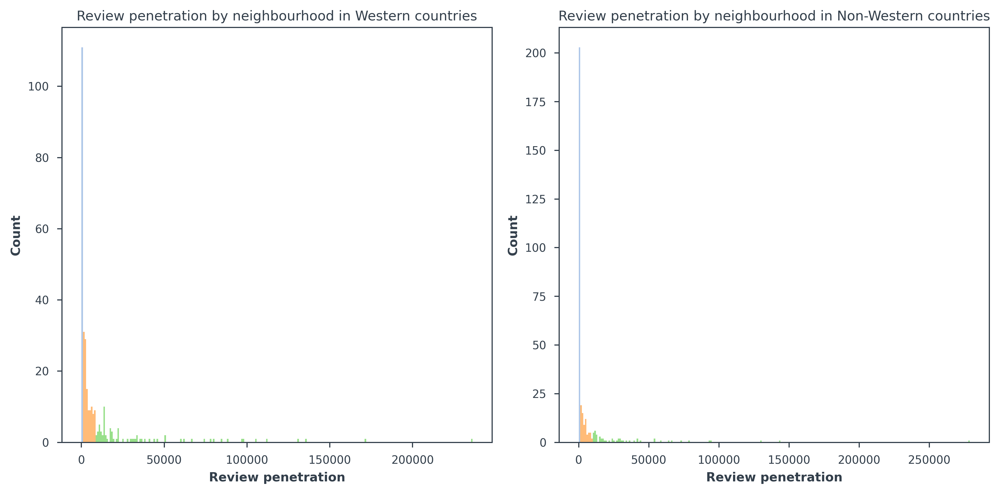

In [69]:
plt.style.use(['mplstyle.config', 'seaborn-paper'])
color = sns.color_palette('tab20')

fig, ax = plt.subplots(1, 2, figsize=(10,5))

N, bins, patches = ax[0].hist(western_comments.groupby(['city', 'neighbourhood_cleansed'])['comments'].count(), bins=250)
ax[0].set_title('Review penetration by neighbourhood in Western countries', pad=5)
ax[0].set_xlabel('Review penetration')  
ax[0].set_ylabel('Count')

bins_western=[]
for i in range(0,1):
    patches[i].set_facecolor(color[1])
bins_western.append(round(patches[0].get_width()*1))
for i in range(1,9):    
    patches[i].set_facecolor(color[3])
bins_western.append(round(patches[0].get_width()*9))
for i in range(9, len(patches)):
    patches[i].set_facecolor(color[5])
bins_western.append(western_comments.groupby(['city', 'neighbourhood_cleansed'])['comments'].count().max())
print(bins_western)


N, bins, patches = ax[1].hist(non_western_comments.groupby(['city', 'neighbourhood_cleansed'])['comments'].count(), bins=250)
ax[1].set_title('Review penetration by neighbourhood in Non-Western countries', pad=5)
ax[1].set_xlabel('Review penetration')  
ax[1].set_ylabel('Count')

bins_non_western=[]
for i in range(0,1):
    patches[i].set_facecolor(color[1])
bins_non_western.append(round(patches[0].get_width()*1))
for i in range(1,9):    
    patches[i].set_facecolor(color[3])
bins_non_western.append(round(patches[0].get_width()*9))
for i in range(9, len(patches)):
    patches[i].set_facecolor(color[5])
bins_non_western.append(non_western_comments.groupby(['city', 'neighbourhood_cleansed'])['comments'].count().max())
print(bins_non_western)

fig.tight_layout();

In [9]:
df1 = pd.DataFrame.merge(western_comments.groupby(['city','neighbourhood_cleansed'])['comments'].count().reset_index(),
                        listings_western_df.groupby(['city','neighbourhood_cleansed'])['id'].count().reset_index(),
                        left_on=['city','neighbourhood_cleansed'], right_on=['city','neighbourhood_cleansed'], how='inner')
df1['type'] = 'Western'
df1['listings_penetration_rate'] = df1.id.apply(lambda x: x/df1.id.max())
df1['comments_penetration_rate'] = df1.comments.apply(lambda x: x/df1.comments.max())
df1

,city,neighbourhood_cleansed,comments,id,type,listings_penetration_rate,comments_penetration_rate
0,London,Barking and Dagenham,2981,396,Western,0.040711,0.012615
1,London,Barnet,18720,1688,Western,0.173538,0.079217
2,London,Bexley,1932,269,Western,0.027655,0.008176
3,London,Brent,46024,2608,Western,0.268120,0.194758
4,London,Bromley,7382,649,Western,0.066721,0.031238
...,...,...,...,...,...,...,...
299,Vancouver,Strathcona,1197,23,Western,0.002365,0.005065
300,Vancouver,Sunset,4392,126,Western,0.012954,0.018585
301,Vancouver,Victoria-Fraserview,2429,91,Western,0.009355,0.010279
302,Vancouver,West End,11336,374,Western,0.038450,0.047970


In [10]:
df2 = pd.DataFrame.merge(non_western_comments.groupby(['city','neighbourhood_cleansed'])['comments'].count().reset_index(),
                        listings_non_western_df.groupby(['city','neighbourhood_cleansed'])['id'].count().reset_index(),
                        left_on=['city','neighbourhood_cleansed'], right_on=['city','neighbourhood_cleansed'], how='inner')
df2['type'] = 'Non Western'
df2['listings_penetration_rate'] = df2.id.apply(lambda x: x/df2.id.max())
df2['comments_penetration_rate'] = df2.comments.apply(lambda x: x/df2.comments.max())
df2

,city,neighbourhood_cleansed,comments,id,type,listings_penetration_rate,comments_penetration_rate
0,Beijing,东城区,30521,3734,Non Western,0.313966,0.109419
1,Beijing,丰台区 / Fengtai,10713,2464,Non Western,0.207181,0.038407
2,Beijing,大兴区 / Daxing,3281,1245,Non Western,0.104683,0.011763
3,Beijing,密云县 / Miyun,3389,1918,Non Western,0.161271,0.012150
4,Beijing,平谷区 / Pinggu,238,242,Non Western,0.020348,0.000853
...,...,...,...,...,...,...,...
322,Tokyo,Sumida Ku,29860,1339,Non Western,0.112587,0.107049
323,Tokyo,Tachikawa Shi,26,6,Non Western,0.000504,0.000093
324,Tokyo,Taito Ku,41924,2048,Non Western,0.172202,0.150299
325,Tokyo,Tama Shi,207,10,Non Western,0.000841,0.000742


In [11]:
df = pd.concat([df1, df2])
df

,city,neighbourhood_cleansed,comments,id,type,listings_penetration_rate,comments_penetration_rate
0,London,Barking and Dagenham,2981,396,Western,0.040711,0.012615
1,London,Barnet,18720,1688,Western,0.173538,0.079217
2,London,Bexley,1932,269,Western,0.027655,0.008176
3,London,Brent,46024,2608,Western,0.268120,0.194758
4,London,Bromley,7382,649,Western,0.066721,0.031238
...,...,...,...,...,...,...,...
322,Tokyo,Sumida Ku,29860,1339,Non Western,0.112587,0.107049
323,Tokyo,Tachikawa Shi,26,6,Non Western,0.000504,0.000093
324,Tokyo,Taito Ku,41924,2048,Non Western,0.172202,0.150299
325,Tokyo,Tama Shi,207,10,Non Western,0.000841,0.000742


<Figure size 1800x1800 with 0 Axes>

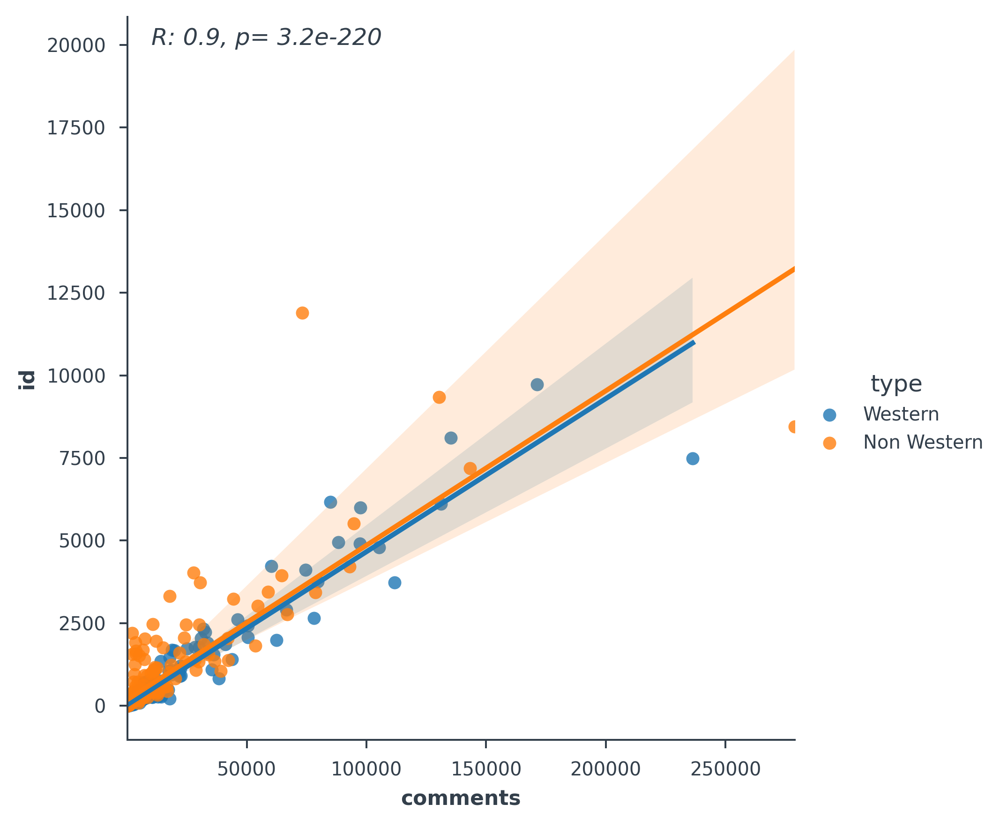

In [18]:
from scipy import stats
plt.style.use(['mplstyle.config', 'seaborn-paper'])

pearson_corr = stats.pearsonr(df.comments, df.id)

plt.figure(figsize=(5,5))

sns.lmplot(x='comments', y='id', hue='type', data=df)
plt.text(10000, 20000,'R: {:.1g}, p= {:.2g}'.format(pearson_corr[0], pearson_corr[1]), fontstyle='italic');

<Figure size 1800x1800 with 0 Axes>

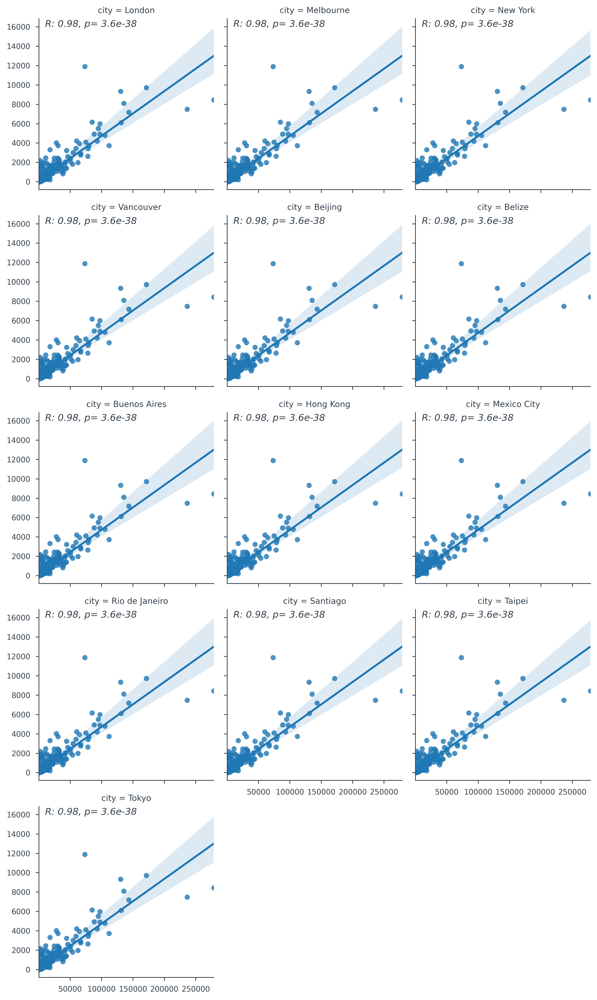

In [20]:
plt.style.use(['mplstyle.config', 'seaborn-paper'])

def annotate(data, **kws):
    for city in df.city.unique():
        pearson_corr = stats.pearsonr(df[df.city==city].comments, df[df.city==city].id)
    
    ax = plt.gca()
    ax.text(10000, 16000,'R: {:.2g}, p= {:.2g}'.format(pearson_corr[0], pearson_corr[1]), fontstyle='italic')

plt.figure(figsize=(5,5))

g = sns.FacetGrid(df, col='city', col_wrap=3, height=3)
g.map(sns.regplot, x='comments', y='id', data=df)
g.set_axis_labels('comments', 'id')
g.set_titles(col_template='{col_name}')
g.map_dataframe(annotate);

[195, 1362, 9727]
[238, 1665, 11893]


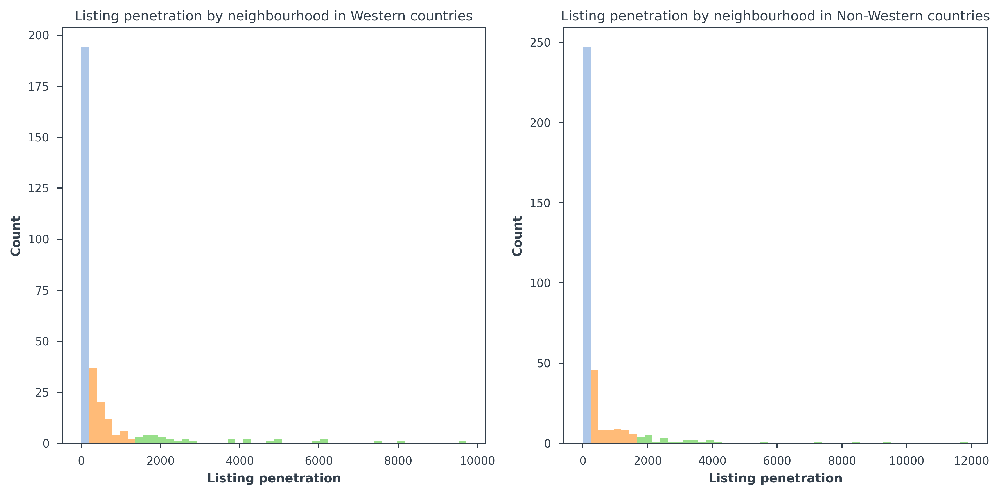

In [21]:
from cycler import cycler

plt.style.use(['mplstyle.config', 'seaborn-paper'])

fig, ax = plt.subplots(1, 2, figsize=(10,5))


N, bins, patches = ax[0].hist(listings_western_df.groupby(['city', 'neighbourhood_cleansed'])['id'].count(), bins=50)
ax[0].set_title('Listing penetration by neighbourhood in Western countries', pad=5)
ax[0].set_xlabel('Listing penetration')  
ax[0].set_ylabel('Count')

bins_listings_western=[]
for i in range(0,1):
    patches[i].set_facecolor(color[1])
bins_listings_western.append(round(patches[0].get_width()*1))
for i in range(1,7):    
    patches[i].set_facecolor(color[3])
bins_listings_western.append(round(patches[0].get_width()*7))
for i in range(7, len(patches)):
    patches[i].set_facecolor(color[5])
bins_listings_western.append(listings_western_df.groupby(['city', 'neighbourhood_cleansed'])['id'].count().max())
print(bins_listings_western)


N, bins, patches = ax[1].hist(listings_non_western_df.groupby(['city', 'neighbourhood_cleansed'])['id'].count(), bins=50)
ax[1].set_title('Listing penetration by neighbourhood in Non-Western countries', pad=5)
ax[1].set_xlabel('Listing penetration')  
ax[1].set_ylabel('Count')

bins_listings_non_western=[]
for i in range(0,1):
    patches[i].set_facecolor(color[1])
bins_listings_non_western.append(round(patches[0].get_width()*1))
for i in range(1,7):    
    patches[i].set_facecolor(color[3])
bins_listings_non_western.append(round(patches[0].get_width()*7))
for i in range(7, len(patches)):
    patches[i].set_facecolor(color[5])
bins_listings_non_western.append(listings_non_western_df.groupby(['city', 'neighbourhood_cleansed'])['id'].count().max())
print(bins_listings_non_western)
    
fig.tight_layout();

### Filter cities from dfs

In [22]:
def filter_city(df, city):
    return df[df['city'] == city]

### Read geojson files

In [23]:
def read_geo_file(file):
    return gpd.read_file(file).drop('neighbourhood_group', axis=1)

### Filter dfs for each city and read geo files

In [24]:
london_comments_df_english = filter_city(western_df_english, 'London')
london_comments_df_non_english = filter_city(western_df_non_english, 'London')
london_listings_df = filter_city(listings_western_df, 'London')
london_map_geodf = read_geo_file('neighbourhoods/london.geojson')

new_york_comments_df_english = filter_city(western_df_english, 'New York')
new_york_comments_df_non_english = filter_city(western_df_non_english, 'New York')
new_york_listings_df = filter_city(listings_western_df, 'New York')
new_york_map_geodf = read_geo_file('neighbourhoods/new_york.geojson')

melbourne_comments_df_english = filter_city(western_df_english, 'Melbourne')
melbourne_comments_df_non_english = filter_city(western_df_non_english, 'Melbourne')
melbourne_listings_df = filter_city(listings_western_df, 'Melbourne')
melbourne_map_geodf = read_geo_file('neighbourhoods/melbourne.geojson')

vancouver_comments_df_english = filter_city(western_df_english, 'Vancouver')
vancouver_comments_df_non_english = filter_city(western_df_non_english, 'Vancouver')
vancouver_listings_df = filter_city(listings_western_df, 'Vancouver')
vancouver_map_geodf = read_geo_file('neighbourhoods/vancouver.geojson')

### Group comments and listings by neighbourhood

In [25]:
def group_comments_by_neighbourhood(comments_df, col_name):
    return comments_df.groupby(['neighbourhood_cleansed'])['comments'].count().reset_index().rename(
                                                                               columns={'comments':col_name})

In [26]:
def group_listings_by_neighbourhood(listings_df):
    return listings_df.groupby(['neighbourhood_cleansed'])['id'].count().reset_index().rename(
                                                                        columns={'id':'listings_count'})

### Merge English, non English comments and listings to one df

In [27]:
def merged_comments_listings_by_neighbourhood(comments_df_english, comments_df_non_english, listings_df):
    comments_english_by_neighbourhood = group_comments_by_neighbourhood(comments_df_english, 'comments_english_count')
    comments_non_english_by_neighbourhood = group_comments_by_neighbourhood(comments_df_non_english, 'comments_non_english_count')
    comments_by_neighbourhood_merged = pd.merge(comments_english_by_neighbourhood, comments_non_english_by_neighbourhood, on='neighbourhood_cleansed', how='inner')
    listings_by_neighbourhood = group_listings_by_neighbourhood(listings_df)
    return pd.merge(comments_by_neighbourhood_merged, listings_by_neighbourhood, on='neighbourhood_cleansed', how='inner')

### Sum English and non English comments

In [28]:
def all_comments_calculate(df):
    df['comments_count'] = df.apply(lambda row: (row['comments_english_count'] + row['comments_non_english_count']), axis=1)

### Merge dfs and compute sum 

In [29]:
def merge_calculate_sum_by_neighbourhood(comments_df_english, comments_df_non_english, listings_df):
    comments_listings_by_neighbourhood = merged_comments_listings_by_neighbourhood(comments_df_english, comments_df_non_english, listings_df)
    all_comments_calculate(comments_listings_by_neighbourhood)
    return comments_listings_by_neighbourhood


### Join comments and listings with map

In [30]:
def join_comments_by_neighbourhood_with_map(map_geodf, comments_by_neighbourhood_df, col_name):
    comments_on_map = map_geodf.set_index('neighbourhood').join(comments_by_neighbourhood_df.set_index('neighbourhood_cleansed')).reset_index().rename(columns={'index':'neighbourhood'})
    comments_on_map[col_name] = comments_on_map[col_name].fillna(0)
    return comments_on_map

In [31]:
def join_listings_by_neighbourhood_with_map(map_geodf, listings_by_neighbourhood_df):
    listings_on_map = map_geodf.set_index('neighbourhood').join(listings_by_neighbourhood_df.set_index('neighbourhood_cleansed')).reset_index().rename(columns={'index':'neighbourhood'})
    listings_on_map['listings_count'] = listings_on_map.listings_count.fillna(0)
    return listings_on_map

### Join merged comments and listings with map

In [32]:
def join_comments_and_listings_by_neighbourhood_with_map(map_geodf, comments_listings_by_neighbourhood):
    comments_listings_on_map = map_geodf.set_index('neighbourhood').join(comments_listings_by_neighbourhood.set_index('neighbourhood_cleansed')).reset_index().rename(columns={'index':'neighbourhood'}).fillna(0)
    return comments_listings_on_map

### Convert df to geodf

In [33]:
def as_geodf(df):
    return gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.longitude, df.latitude))

### Plot English, non English comments and listings on one plot

In [54]:
import mapclassify as mp

plt.style.use(['mplstyle.config', 'seaborn-paper'])

def comments_listings_one_plot(comments_listings_by_neighbourhood, xlim=None, ylim=None, city=None):

    
    fig,([ax1,ax2],[ax3,ax4]) = plt.subplots(2, 2, figsize=(15,10), sharex=True, sharey=True)
    
    bins = mp.EqualInterval(comments_listings_by_neighbourhood['comments_count'], k=5).bins
    bins2 = mp.EqualInterval(comments_listings_by_neighbourhood['listings_count'], k=5).bins
    
    comments_listings_by_neighbourhood.plot('comments_english_count', scheme='UserDefined', ax=ax1, edgecolor='#DDDDDD',
                                            cmap='Oranges', legend=True, classification_kwds=dict(bins=bins_western),
                                            legend_kwds={'loc':'lower right', 'bbox_to_anchor':(1.2, 0.1), 
                                                         'title':'Count\n', 'frameon':False} 
    )
    ax1.set_title('English comments')
    ax1.set_xlim(xlim)
    ax1.set_ylim(ylim)
    
    comments_listings_by_neighbourhood.plot('comments_non_english_count', scheme='UserDefined', ax=ax2, edgecolor='#DDDDDD',
                                            cmap='Oranges', legend=True, classification_kwds=dict(bins=bins_western),
                                            legend_kwds={'loc':'lower right', 'bbox_to_anchor':(1.2, 0.1), 
                                                         'title':'Count\n', 'frameon':False}
    )
    ax2.set_title('Non English comments')

    comments_listings_by_neighbourhood.plot('comments_count', scheme='UserDefined', ax=ax3, edgecolor='#DDDDDD',
                                            cmap='Oranges', legend=True, classification_kwds=dict(bins=bins_western),
                                            legend_kwds={'loc':'lower right', 'bbox_to_anchor':(1.2, 0.1), 
                                                         'title':'Count\n', 'frameon':False}
    )
    ax3.set_title('All comments')
    
    comments_listings_by_neighbourhood.plot('listings_count', scheme='UserDefined', ax=ax4, edgecolor='#DDDDDD',
                                            cmap='Blues', legend=True, classification_kwds=dict(bins=bins_listings_western),
                                            legend_kwds={'loc':'lower right', 'bbox_to_anchor':(1.2, 0.1), 
                                                         'title':'Count\n', 'frameon':False}
    )
    ax4.set_title('Listings')

    fig.tight_layout()
    fig.suptitle(city, y=1.05)
    
    
    for ax in (ax1,ax2,ax3,ax4):
        ax.axis('off')

In [44]:
london_comments_listings_by_neighbourhood = merge_calculate_sum_by_neighbourhood(
                                london_comments_df_english, london_comments_df_non_english, london_listings_df)
new_york_comments_listings_by_neighbourhood = merge_calculate_sum_by_neighbourhood(
                                new_york_comments_df_english, new_york_comments_df_non_english, new_york_listings_df)
melbourne_comments_listings_by_neighbourhood = merge_calculate_sum_by_neighbourhood(
                                melbourne_comments_df_english, melbourne_comments_df_non_english, melbourne_listings_df)
vancouver_comments_listings_by_neighbourhood = merge_calculate_sum_by_neighbourhood(
                                vancouver_comments_df_english, vancouver_comments_df_non_english, vancouver_listings_df)

In [45]:
london_comments_listings_by_neighbourhood.comments_count.max()

171225

In [46]:
new_york_comments_listings_by_neighbourhood.comments_count.max()

111725

In [47]:
melbourne_comments_listings_by_neighbourhood.comments_count.max()

236314

In [48]:
london_comments_listings_by_neighbourhood_on_map_geodf = join_comments_and_listings_by_neighbourhood_with_map(
                                                    london_map_geodf, london_comments_listings_by_neighbourhood)
new_york_comments_listings_by_neighbourhood_on_map_geodf = join_comments_and_listings_by_neighbourhood_with_map(
                                                    new_york_map_geodf, new_york_comments_listings_by_neighbourhood)
melbourne_comments_listings_by_neighbourhood_on_map_geodf = join_comments_and_listings_by_neighbourhood_with_map(
                                                    melbourne_map_geodf, melbourne_comments_listings_by_neighbourhood)
vancouver_comments_listings_by_neighbourhood_on_map_geodf = join_comments_and_listings_by_neighbourhood_with_map(
                                                    vancouver_map_geodf, vancouver_comments_listings_by_neighbourhood)

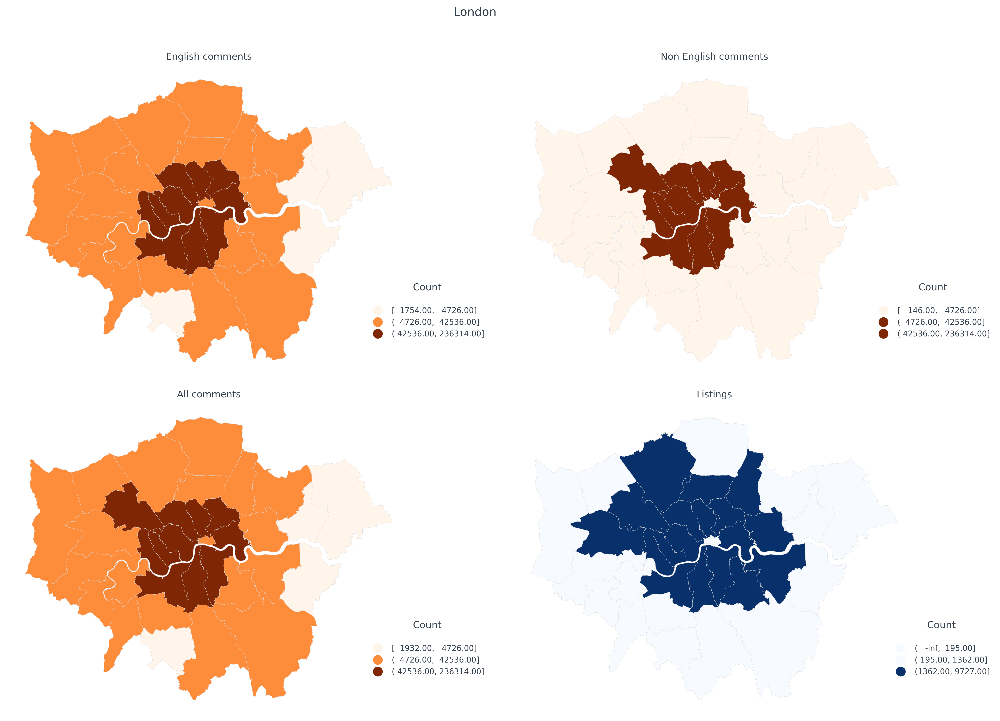

In [55]:
comments_listings_one_plot(london_comments_listings_by_neighbourhood_on_map_geodf, city='London')

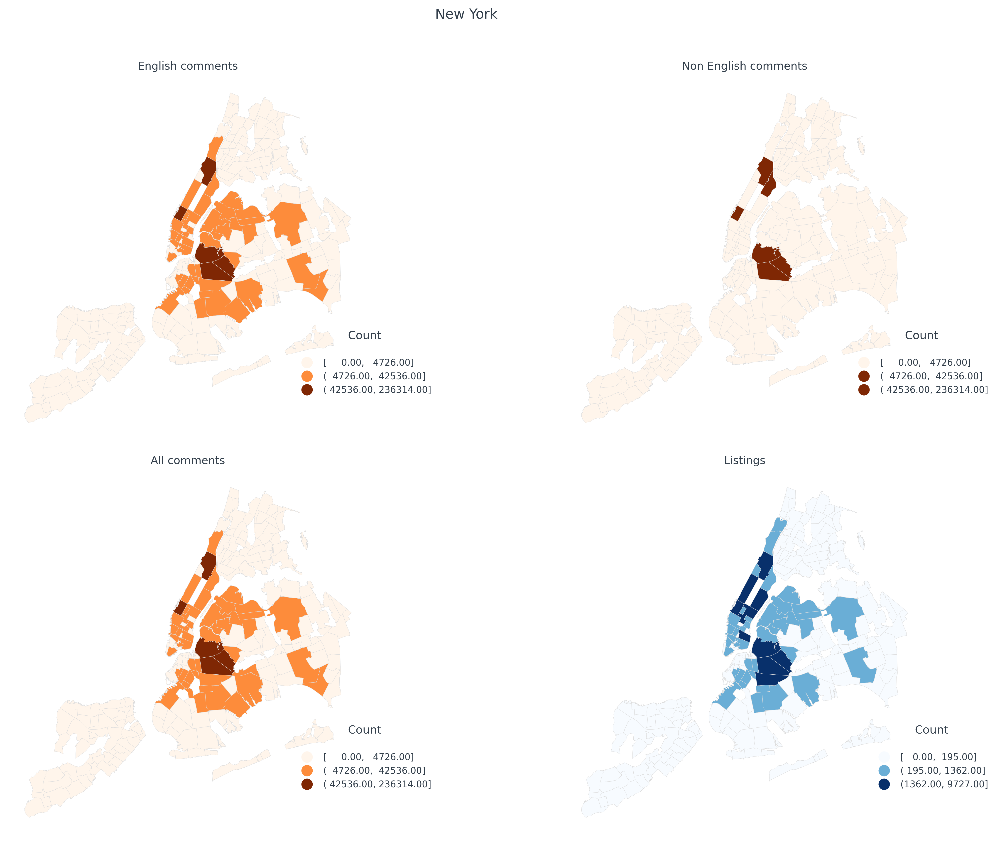

In [56]:
comments_listings_one_plot(new_york_comments_listings_by_neighbourhood_on_map_geodf, city='New York')

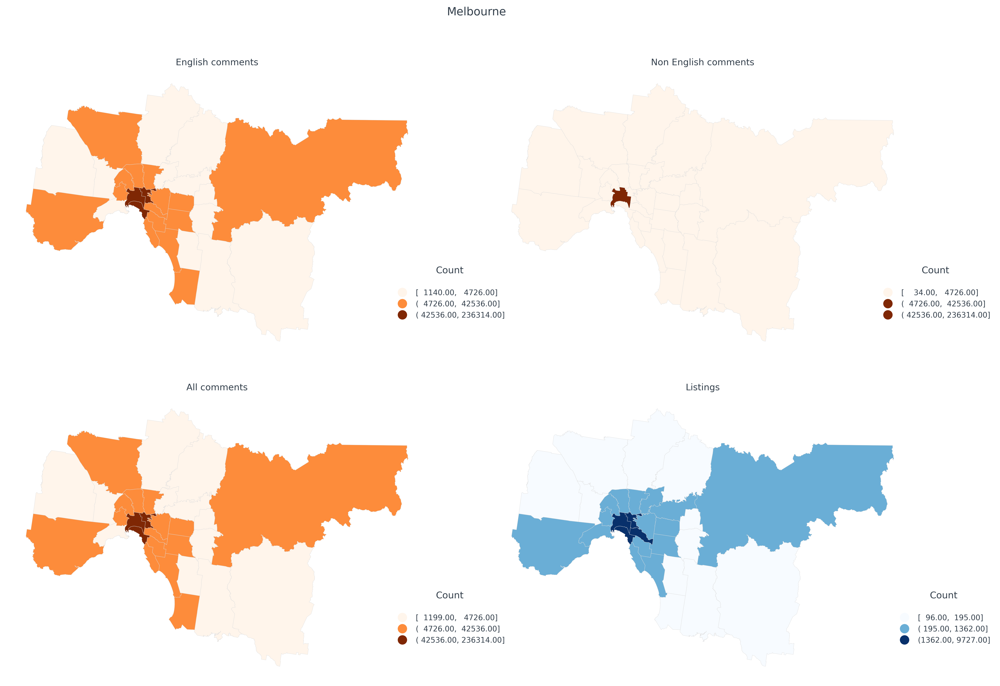

In [57]:
comments_listings_one_plot(melbourne_comments_listings_by_neighbourhood_on_map_geodf, city='Melbourne')

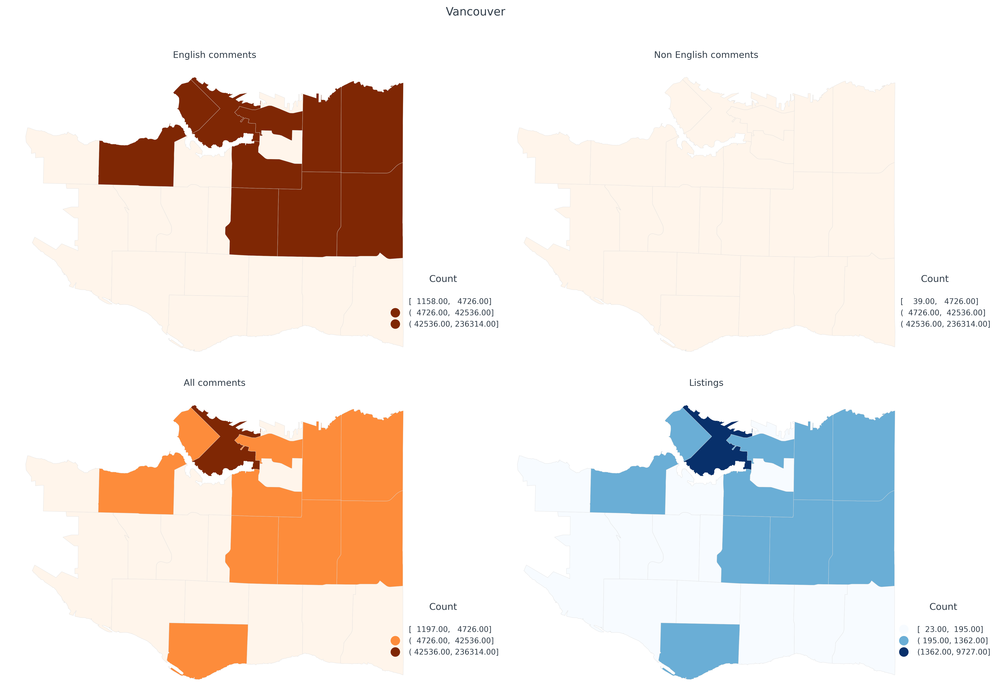

In [58]:
comments_listings_one_plot(vancouver_comments_listings_by_neighbourhood_on_map_geodf, city='Vancouver')

### Plot comments English

In [63]:
plt.style.use(['mplstyle.config', 'seaborn-paper'])
color = sns.color_palette('tab20')

def plot_comments_on_map1(comments_and_maps, xsize, ysize, df):
    fig, axs = plt.subplots(xsize, ysize, figsize=(15, 10))
    i = 0
    j = 0
    for a in comments_and_maps:
        xlim = None
        ylim = None
        if len(a) == 5:
            [map_geodf, comments_geodf, city, xlim, ylim] = a
        else:
            [map_geodf, comments_geodf, city] = a
        plot_comments_on_map2(axs[i, j], fig, map_geodf, comments_geodf, city, xlim, ylim)
        j = j + 1
        if j > (xsize - 1): 
            i = i + 1
            j = 0

In [25]:
plt.style.use(['mplstyle.config', 'seaborn-paper'])
color = sns.color_palette('tab20')

def plot_comments_on_map2(ax, fig, map_geodf, comments_geodf, city, xlim=None, ylim=None):
    ax.axis('off')
    if xlim:
        ax.set_xlim(xlim)
    if ylim:
        ax.set_ylim(ylim)
    ax.set_title('Number of reviews by neighbourhood in ' + city)
    plt.tight_layout
    map_geodf.plot(ax=ax, color=color[0], edgecolor='white')
    comments_geodf.plot(ax=ax, marker='.', markersize=1, color='yellow')

In [26]:
london_comments_english_by_neighbourhood_on_map_geodf = join_comments_by_neighbourhood_with_map(
                                                        london_map_geodf, group_comments_by_neighbourhood(
                                                        london_comments_df_english, 'comments_english_count'), 
                                                        'comments_english_count')
london_comments_english_geodf = as_geodf(london_comments_df_english)

new_york_comments_english_by_neighbourhood_on_map_geodf = join_comments_by_neighbourhood_with_map(
                                                        new_york_map_geodf, group_comments_by_neighbourhood(
                                                        new_york_comments_df_english, 'comments_english_count'), 
                                                        'comments_english_count')
new_york_comments_english_geodf = as_geodf(new_york_comments_df_english)

melbourne_comments_english_by_neighbourhood_on_map_geodf = join_comments_by_neighbourhood_with_map(
                                                        melbourne_map_geodf, group_comments_by_neighbourhood(
                                                        melbourne_comments_df_english, 'comments_english_count'), 
                                                        'comments_english_count')
melbourne_comments_english_geodf = as_geodf(melbourne_comments_df_english)

vancouver_comments_english_by_neighbourhood_on_map_geodf = join_comments_by_neighbourhood_with_map(
                                                        vancouver_map_geodf, group_comments_by_neighbourhood(
                                                        vancouver_comments_df_english, 'comments_english_count'), 
                                                        'comments_english_count')
vancouver_comments_english_geodf = as_geodf(vancouver_comments_df_english)

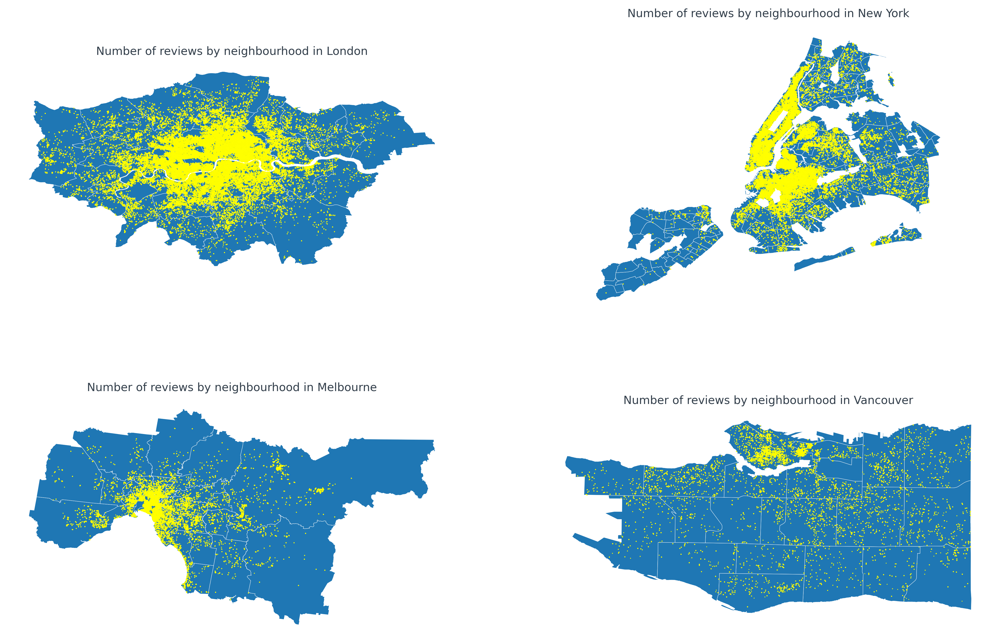

In [27]:
plot_comments_on_map1(
    [[london_map_geodf, london_comments_english_geodf, 'London'], 
     [new_york_map_geodf, new_york_comments_english_geodf, 'New York'],
     [melbourne_map_geodf, melbourne_comments_english_geodf, 'Melbourne'],
     [vancouver_map_geodf, vancouver_comments_english_geodf, 'Vancouver']],
    2, 2, western_df_english)

### Plot comments non English

In [28]:
london_comments_non_english_by_neighbourhood_on_map_geodf = join_comments_by_neighbourhood_with_map(london_map_geodf, group_comments_by_neighbourhood(london_comments_df_non_english, 'comments_non_english_count'), 'comments_non_english_count')
london_comments_non_english_geodf = as_geodf(london_comments_df_non_english)

new_york_comments_non_english_by_neighbourhood_on_map_geodf = join_comments_by_neighbourhood_with_map(new_york_map_geodf, group_comments_by_neighbourhood(new_york_comments_df_non_english, 'comments_non_english_count'), 'comments_non_english_count')
new_york_comments_non_english_geodf = as_geodf(new_york_comments_df_non_english)

melbourne_comments_non_english_by_neighbourhood_on_map_geodf = join_comments_by_neighbourhood_with_map(melbourne_map_geodf, group_comments_by_neighbourhood(melbourne_comments_df_non_english, 'comments_non_english_count'), 'comments_non_english_count')
melbourne_comments_non_english_geodf = as_geodf(melbourne_comments_df_non_english)

vancouver_comments_non_english_by_neighbourhood_on_map_geodf = join_comments_by_neighbourhood_with_map(vancouver_map_geodf, group_comments_by_neighbourhood(vancouver_comments_df_non_english, 'comments_non_english_count'), 'comments_non_english_count')
vancouver_comments_non_english_geodf = as_geodf(vancouver_comments_df_non_english)

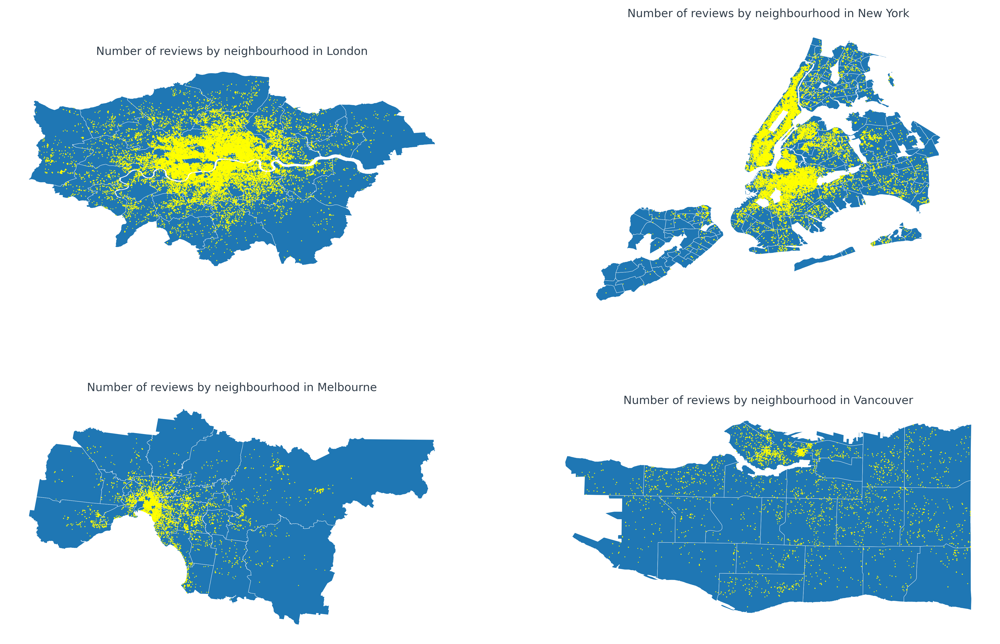

In [29]:
plot_comments_on_map1(
    [[london_map_geodf, london_comments_non_english_geodf, 'London'], 
     [new_york_map_geodf, new_york_comments_non_english_geodf, 'New York'],
     [melbourne_map_geodf, melbourne_comments_non_english_geodf, 'Melbourne'],
     [vancouver_map_geodf, vancouver_comments_non_english_geodf, 'Vancouver']],
    2, 2, western_df_non_english)

### Plot listings 

In [30]:
plt.style.use(['mplstyle.config', 'seaborn-paper'])
color = sns.color_palette('tab20')

def plot_listings_on_map1(listings_and_maps, xsize, ysize, df):
    fig, axs = plt.subplots(xsize, ysize, figsize=(15, 10))
    i = 0
    j = 0
    for a in listings_and_maps:
        xlim = None
        ylim = None
        if len(a) == 5:
            [map_geodf, listings_geodf, city, xlim, ylim] = a
        else:
            [map_geodf, listings_geodf, city] = a
        plot_listings_on_map2(axs[i, j], fig, map_geodf, listings_geodf, city, xlim, ylim)
        j = j + 1
        if j > (xsize - 1): 
            i = i + 1
            j = 0

In [31]:
plt.style.use(['mplstyle.config', 'seaborn-paper'])
color = sns.color_palette('tab20')

def plot_listings_on_map2(ax, fig, map_geodf, listings_geodf, city, xlim=None, ylim=None):
    ax.axis('off')
    if xlim:
        ax.set_xlim(xlim)
    if ylim:
        ax.set_ylim(ylim)
    ax.set_title('Number of listings by neighbourhood in ' + city)
    plt.tight_layout()
    map_geodf.plot(ax=ax, color=color[0], edgecolor='white')
    listings_geodf.plot(ax=ax, marker='.', markersize=3, color='yellow')

In [32]:
london_listings_by_neighbourhood_on_map_geodf = join_listings_by_neighbourhood_with_map(london_map_geodf, group_listings_by_neighbourhood(london_listings_df))
london_listings_geodf = as_geodf(london_listings_df)

new_york_listings_by_neighbourhood_on_map_geodf = join_listings_by_neighbourhood_with_map(new_york_map_geodf, group_listings_by_neighbourhood(new_york_listings_df))
new_york_listings_geodf = as_geodf(new_york_listings_df)

melbourne_listings_by_neighbourhood_on_map_geodf = join_listings_by_neighbourhood_with_map(melbourne_map_geodf, group_listings_by_neighbourhood(melbourne_listings_df))
melbourne_listings_geodf = as_geodf(melbourne_listings_df)

vancouver_listings_by_neighbourhood_on_map_geodf = join_listings_by_neighbourhood_with_map(vancouver_map_geodf, group_listings_by_neighbourhood(vancouver_listings_df))
vancouver_listings_geodf = as_geodf(vancouver_listings_df)

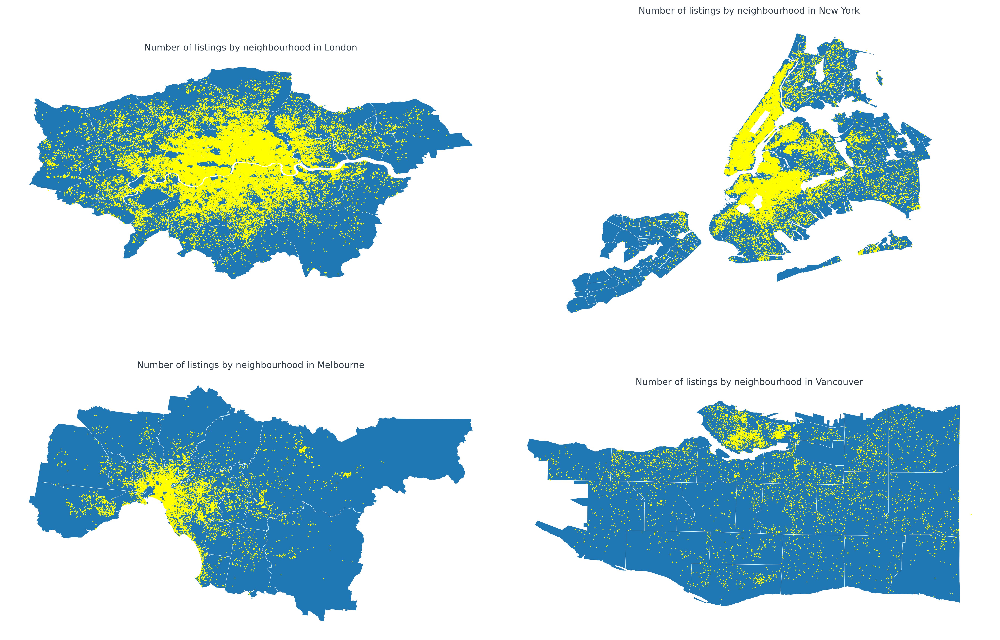

In [33]:
plot_listings_on_map1(
    [[london_map_geodf, london_listings_geodf, 'London'], 
     [new_york_map_geodf, new_york_listings_geodf, 'New York'],
     [melbourne_map_geodf, melbourne_listings_geodf, 'Melbourne'],
     [vancouver_map_geodf, vancouver_listings_geodf, 'Vancouver']],
    2, 2, listings_western_df)

### Plot comments English by neighbourhood

In [252]:
plt.style.use(['mplstyle.config', 'seaborn-paper'])

def plot_comments_by_neighbourhood_on_map1(comments_by_neighbourhood, xsize, ysize, df, col_name):
    fig, axs = plt.subplots(xsize, ysize, figsize=(15, 10))
    color = 'Oranges'
    sm = plt.cm.ScalarMappable(cmap=plt.cm.get_cmap(color, 5), norm=plt.Normalize(vmin=0, vmax=group_comments_by_neighbourhood(df, col_name)[col_name].max()))
    sm._A = []
    cbar = fig.colorbar(sm)
    #cbar.ax.tick_params()
    i = 0
    j = 0
    for a in comments_by_neighbourhood:
        xlim = None
        ylim = None
        if len(a) == 4:
            [comments_geodf, city, xlim, ylim] = a
        else:
            [comments_geodf, city] = a
        plot_comments_by_neighbourhood_on_map2(axs[i, j], fig, color, comments_geodf, city, col_name, xlim, ylim)
        j = j + 1
        if j > (xsize - 1): 
            i = i + 1
            j = 0

In [253]:
plt.style.use(['mplstyle.config', 'seaborn-paper'])

def plot_comments_by_neighbourhood_on_map2(ax, fig, color, comments_by_neighbourhood_geodf, city, col_name, xlim=None, ylim=None):
    ax.axis('off')
    if xlim:
        ax.set_xlim(xlim)
    if ylim:
        ax.set_ylim(ylim)
    ax.set_title('Number of reviews by neighbourhood in ' + city)
    comments_by_neighbourhood_geodf.plot(col_name, cmap=color, ax=ax, edgecolor='#DDDDDD');

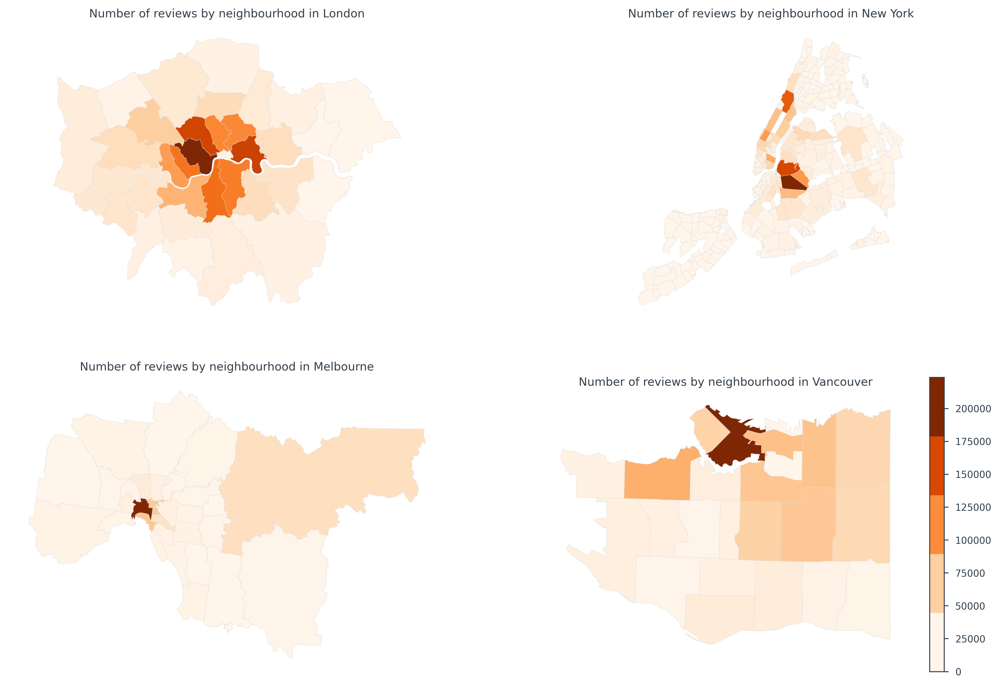

In [254]:
plot_comments_by_neighbourhood_on_map1(
    [[london_comments_english_by_neighbourhood_on_map_geodf, 'London'], 
     [new_york_comments_english_by_neighbourhood_on_map_geodf, 'New York'],
     [melbourne_comments_english_by_neighbourhood_on_map_geodf, 'Melbourne'],
     [vancouver_comments_english_by_neighbourhood_on_map_geodf, 'Vancouver']], 
    2, 2, western_df_english, 'comments_english_count')

### Plot non English comments by neighbourhood

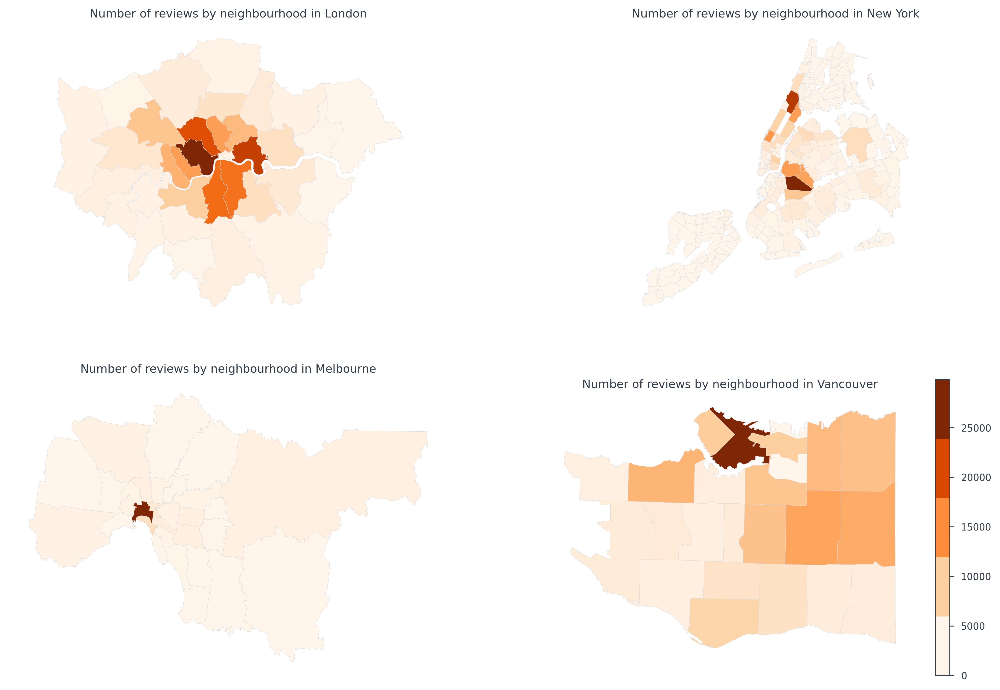

In [255]:
plot_comments_by_neighbourhood_on_map1(
    [[london_comments_non_english_by_neighbourhood_on_map_geodf, 'London'], 
     [new_york_comments_non_english_by_neighbourhood_on_map_geodf, 'New York'],
     [melbourne_comments_non_english_by_neighbourhood_on_map_geodf, 'Melbourne'],
     [vancouver_comments_non_english_by_neighbourhood_on_map_geodf, 'Vancouver']], 
    2, 2, western_df_non_english, 'comments_non_english_count')

### Plot listings by neighbourhood

In [256]:
plt.style.use(['mplstyle.config', 'seaborn-paper'])

def plot_listings_by_neighbourhood_on_map1(listings_by_neighbourhood, xsize, ysize, df):
    fig, axs = plt.subplots(xsize, ysize, figsize=(15, 10))
    color = 'Oranges'
    sm = plt.cm.ScalarMappable(cmap=plt.cm.get_cmap(color, 5), norm=plt.Normalize(vmin=0, vmax=group_listings_by_neighbourhood(df)['listings_count'].max()))
    sm._A = []
    cbar = fig.colorbar(sm)
    cbar.ax.tick_params()
    i = 0
    j = 0
    for a in listings_by_neighbourhood:
        xlim = None
        ylim = None
        if len(a) == 4:
            [listings_geodf, city, xlim, ylim] = a
        else:
            [listings_geodf, city] = a
            
        if xsize == 1 & ysize == 1:
            ax = axs
        elif xsize == 1:
            ax = axs[i]
        elif ysize == 1:
            ax = axs[j]
        else:
            ax = axs[i, j]
        plot_listings_by_neighbourhood_on_map2(axs[i, j], fig, color, listings_geodf, city, xlim, ylim)
        j = j + 1
        if j > (xsize - 1): 
            i = i + 1
            j = 0

In [257]:
plt.style.use(['mplstyle.config', 'seaborn-paper'])

def plot_listings_by_neighbourhood_on_map2(ax, fig, color, listings_by_neighbourhood_geodf, city, xlim=None, ylim=None):
    ax.axis('off')
    if xlim:
        ax.set_xlim(xlim)
    if ylim:
        ax.set_ylim(ylim)
    ax.set_title('Number of listings by neighbourhood in ' + city)
    listings_by_neighbourhood_geodf.plot('listings_count', cmap=color, ax=ax, edgecolor='#DDDDDD');

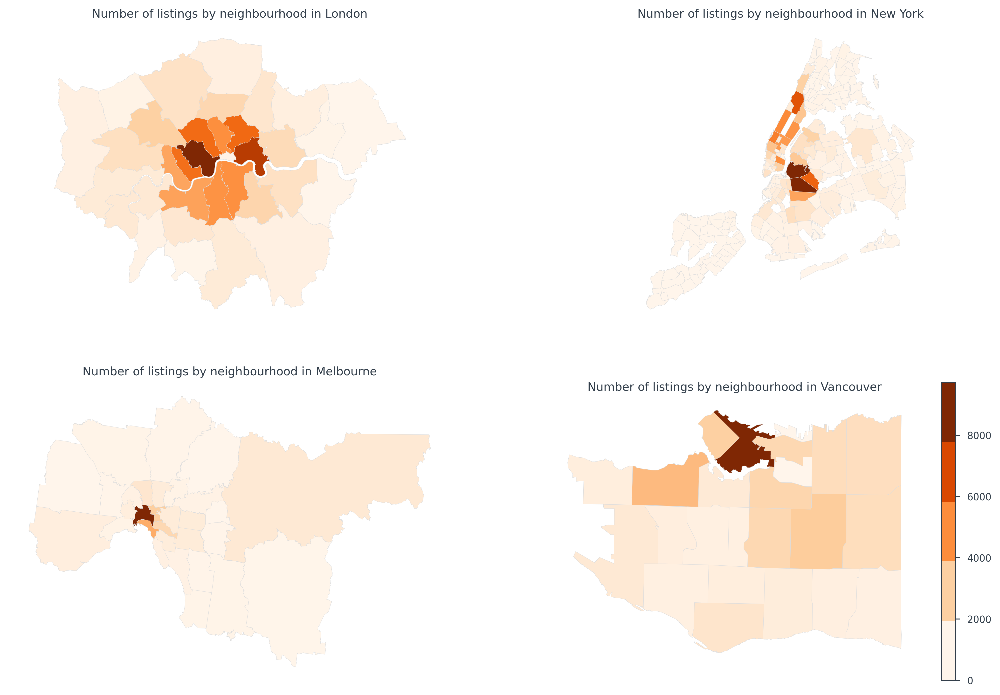

In [258]:
plot_listings_by_neighbourhood_on_map1(
    [[london_listings_by_neighbourhood_on_map_geodf, 'London'], 
     [new_york_listings_by_neighbourhood_on_map_geodf, 'New York'],
     [melbourne_listings_by_neighbourhood_on_map_geodf, 'Melbourne'],
     [vancouver_listings_by_neighbourhood_on_map_geodf, 'Vancouver']], 
    2, 2, listings_western_df)

## Non-Western countries analysis

### Filter cities from df

In [49]:
beijing_comments_df_english = filter_city(non_western_df_english, 'Beijing')
beijing_comments_df_non_english = filter_city(non_western_df_non_english, 'Beijing')
beijing_listings_df = filter_city(listings_non_western_df, 'Beijing')
beijing_map_geodf = read_geo_file('neighbourhoods/beijing.geojson')

belize_comments_df_english = filter_city(non_western_df_english, 'Belize')
belize_comments_df_non_english = filter_city(non_western_df_non_english, 'Belize')
belize_listings_df = filter_city(listings_non_western_df, 'Belize')
belize_map_geodf = read_geo_file('neighbourhoods/belize.geojson')

buenos_aires_comments_df_english = filter_city(non_western_df_english, 'Buenos Aires')
buenos_aires_comments_df_non_english = filter_city(non_western_df_non_english, 'Buenos Aires')
buenos_aires_listings_df = filter_city(listings_non_western_df, 'Buenos Aires')
buenos_aires_map_geodf = read_geo_file('neighbourhoods/buenos_aires.geojson')

hong_kong_comments_df_english = filter_city(non_western_df_english, 'Hong Kong')
hong_kong_comments_df_non_english = filter_city(non_western_df_non_english, 'Hong Kong')
hong_kong_listings_df = filter_city(listings_non_western_df, 'Hong Kong')
hong_kong_map_geodf = read_geo_file('neighbourhoods/hong_kong.geojson')

mexico_city_comments_df_english = filter_city(non_western_df_english, 'Mexico City')
mexico_city_comments_df_non_english = filter_city(non_western_df_non_english, 'Mexico City')
mexico_city_listings_df = filter_city(listings_non_western_df, 'Mexico City')
mexico_city_map_geodf = read_geo_file('neighbourhoods/mexico_city.geojson')

rio_de_janeiro_comments_df_english = filter_city(non_western_df_english, 'Rio de Janeiro')
rio_de_janeiro_comments_df_non_english = filter_city(non_western_df_non_english, 'Rio de Janeiro')
rio_de_janeiro_listings_df = filter_city(listings_non_western_df, 'Rio de Janeiro')
rio_de_janeiro_map_geodf = read_geo_file('neighbourhoods/rio_de_janeiro.geojson')

santiago_comments_df_english = filter_city(non_western_df_english, 'Santiago')
santiago_comments_df_non_english = filter_city(non_western_df_non_english, 'Santiago')
santiago_listings_df = filter_city(listings_non_western_df, 'Santiago')
santiago_map_geodf = read_geo_file('neighbourhoods/santiago.geojson')

taipei_comments_df_english = filter_city(non_western_df_english, 'Taipei')
taipei_comments_df_non_english = filter_city(non_western_df_non_english, 'Taipei')
taipei_listings_df = filter_city(listings_non_western_df, 'Taipei')
taipei_map_geodf = read_geo_file('neighbourhoods/taipei.geojson')

tokyo_comments_df_english = filter_city(non_western_df_english, 'Tokyo')
tokyo_comments_df_non_english = filter_city(non_western_df_non_english, 'Tokyo')
tokyo_listings_df = filter_city(listings_non_western_df, 'Tokyo')
tokyo_map_geodf = read_geo_file('neighbourhoods/tokyo.geojson')

### Group comments English

In [156]:
beijing_comments_english_by_neighbourhood_on_map_geodf = join_comments_by_neighbourhood_with_map(beijing_map_geodf, group_comments_by_neighbourhood(beijing_comments_df_english, 'comments_english_count'), 'comments_english_count')
beijing_comments_english_geodf = as_geodf(beijing_comments_df_english)

belize_comments_english_by_neighbourhood_on_map_geodf = join_comments_by_neighbourhood_with_map(belize_map_geodf, group_comments_by_neighbourhood(belize_comments_df_english, 'comments_english_count'), 'comments_english_count')
belize_comments_english_geodf = as_geodf(belize_comments_df_english)

buenos_aires_comments_english_by_neighbourhood_on_map_geodf = join_comments_by_neighbourhood_with_map(buenos_aires_map_geodf, group_comments_by_neighbourhood(buenos_aires_comments_df_english, 'comments_english_count'), 'comments_english_count')
buenos_aires_comments_english_geodf = as_geodf(buenos_aires_comments_df_english)

hong_kong_comments_english_by_neighbourhood_on_map_geodf = join_comments_by_neighbourhood_with_map(hong_kong_map_geodf, group_comments_by_neighbourhood(hong_kong_comments_df_english, 'comments_english_count'), 'comments_english_count')
hong_kong_comments_english_geodf = as_geodf(hong_kong_comments_df_english)

mexico_city_comments_english_by_neighbourhood_on_map_geodf = join_comments_by_neighbourhood_with_map(mexico_city_map_geodf, group_comments_by_neighbourhood(mexico_city_comments_df_english, 'comments_english_count'), 'comments_english_count')
mexico_city_comments_english_geodf = as_geodf(mexico_city_comments_df_english)

rio_de_janeiro_comments_english_by_neighbourhood_on_map_geodf = join_comments_by_neighbourhood_with_map(rio_de_janeiro_map_geodf, group_comments_by_neighbourhood(rio_de_janeiro_comments_df_english, 'comments_english_count'), 'comments_english_count')
rio_de_janeiro_comments_english_geodf = as_geodf(rio_de_janeiro_comments_df_english)

santiago_comments_english_by_neighbourhood_on_map_geodf = join_comments_by_neighbourhood_with_map(santiago_map_geodf, group_comments_by_neighbourhood(santiago_comments_df_english, 'comments_english_count'), 'comments_english_count')
santiago_comments_english_geodf = as_geodf(santiago_comments_df_english)

taipei_comments_english_by_neighbourhood_on_map_geodf = join_comments_by_neighbourhood_with_map(taipei_map_geodf, group_comments_by_neighbourhood(taipei_comments_df_english, 'comments_english_count'), 'comments_english_count')
taipei_comments_english_geodf = as_geodf(taipei_comments_df_english)

tokyo_comments_english_by_neighbourhood_on_map_geodf = join_comments_by_neighbourhood_with_map(tokyo_map_geodf, group_comments_by_neighbourhood(tokyo_comments_df_english, 'comments_english_count'), 'comments_english_count')
tokyo_comments_english_geodf = as_geodf(tokyo_comments_df_english)

### Group comments non English

In [157]:
beijing_comments_non_english_by_neighbourhood_on_map_geodf = join_comments_by_neighbourhood_with_map(beijing_map_geodf, group_comments_by_neighbourhood(beijing_comments_df_non_english, 'comments_non_english_count'), 'comments_non_english_count')
beijing_comments_non_english_geodf = as_geodf(beijing_comments_df_non_english)

belize_comments_non_english_by_neighbourhood_on_map_geodf = join_comments_by_neighbourhood_with_map(belize_map_geodf, group_comments_by_neighbourhood(belize_comments_df_non_english, 'comments_non_english_count'), 'comments_non_english_count')
belize_comments_non_english_geodf = as_geodf(belize_comments_df_non_english)

buenos_aires_comments_non_english_by_neighbourhood_on_map_geodf = join_comments_by_neighbourhood_with_map(buenos_aires_map_geodf, group_comments_by_neighbourhood(buenos_aires_comments_df_non_english, 'comments_non_english_count'), 'comments_non_english_count')
buenos_aires_comments_non_english_geodf = as_geodf(buenos_aires_comments_df_non_english)

hong_kong_comments_non_english_by_neighbourhood_on_map_geodf = join_comments_by_neighbourhood_with_map(hong_kong_map_geodf, group_comments_by_neighbourhood(hong_kong_comments_df_non_english, 'comments_non_english_count'), 'comments_non_english_count')
hong_kong_comments_non_english_geodf = as_geodf(hong_kong_comments_df_non_english)

mexico_city_comments_non_english_by_neighbourhood_on_map_geodf = join_comments_by_neighbourhood_with_map(mexico_city_map_geodf, group_comments_by_neighbourhood(mexico_city_comments_df_non_english, 'comments_non_english_count'), 'comments_non_english_count')
mexico_city_comments_non_english_geodf = as_geodf(mexico_city_comments_df_non_english)

rio_de_janeiro_comments_non_english_by_neighbourhood_on_map_geodf = join_comments_by_neighbourhood_with_map(rio_de_janeiro_map_geodf, group_comments_by_neighbourhood(rio_de_janeiro_comments_df_non_english, 'comments_non_english_count'), 'comments_non_english_count')
rio_de_janeiro_comments_non_english_geodf = as_geodf(rio_de_janeiro_comments_df_non_english)

santiago_comments_non_english_by_neighbourhood_on_map_geodf = join_comments_by_neighbourhood_with_map(santiago_map_geodf, group_comments_by_neighbourhood(santiago_comments_df_non_english, 'comments_non_english_count'), 'comments_non_english_count')
santiago_comments_non_english_geodf = as_geodf(santiago_comments_df_non_english)

taipei_comments_non_english_by_neighbourhood_on_map_geodf = join_comments_by_neighbourhood_with_map(taipei_map_geodf, group_comments_by_neighbourhood(taipei_comments_df_non_english, 'comments_non_english_count'), 'comments_non_english_count')
taipei_comments_non_english_geodf = as_geodf(taipei_comments_df_non_english)

tokyo_comments_non_english_by_neighbourhood_on_map_geodf = join_comments_by_neighbourhood_with_map(tokyo_map_geodf, group_comments_by_neighbourhood(tokyo_comments_df_non_english, 'comments_non_english_count'), 'comments_non_english_count')
tokyo_comments_non_english_geodf = as_geodf(tokyo_comments_df_non_english)

### Group listings

In [158]:
beijing_listings_by_neighbourhood_on_map_geodf = join_listings_by_neighbourhood_with_map(beijing_map_geodf, group_listings_by_neighbourhood(beijing_listings_df))
beijing_listings_geodf = as_geodf(beijing_listings_df)

belize_listings_by_neighbourhood_on_map_geodf = join_listings_by_neighbourhood_with_map(belize_map_geodf, group_listings_by_neighbourhood(belize_listings_df))
belize_listings_geodf = as_geodf(belize_listings_df)

buenos_aires_listings_by_neighbourhood_on_map_geodf = join_listings_by_neighbourhood_with_map(buenos_aires_map_geodf, group_listings_by_neighbourhood(buenos_aires_listings_df))
buenos_aires_listings_geodf = as_geodf(buenos_aires_listings_df)

hong_kong_listings_by_neighbourhood_on_map_geodf = join_listings_by_neighbourhood_with_map(hong_kong_map_geodf, group_listings_by_neighbourhood(hong_kong_listings_df))
hong_kong_listings_geodf = as_geodf(hong_kong_listings_df)

mexico_city_listings_by_neighbourhood_on_map_geodf = join_listings_by_neighbourhood_with_map(mexico_city_map_geodf, group_listings_by_neighbourhood(mexico_city_listings_df))
mexico_city_listings_geodf = as_geodf(mexico_city_listings_df)

rio_de_janeiro_listings_by_neighbourhood_on_map_geodf = join_listings_by_neighbourhood_with_map(rio_de_janeiro_map_geodf, group_listings_by_neighbourhood(rio_de_janeiro_listings_df))
rio_de_janeiro_listings_geodf = as_geodf(rio_de_janeiro_listings_df)

santiago_listings_by_neighbourhood_on_map_geodf = join_listings_by_neighbourhood_with_map(santiago_map_geodf, group_listings_by_neighbourhood(santiago_listings_df))
santiago_listings_geodf = as_geodf(santiago_listings_df)

taipei_listings_by_neighbourhood_on_map_geodf = join_listings_by_neighbourhood_with_map(taipei_map_geodf, group_listings_by_neighbourhood(taipei_listings_df))
taipei_listings_geodf = as_geodf(taipei_listings_df)

tokyo_listings_by_neighbourhood_on_map_geodf = join_listings_by_neighbourhood_with_map(tokyo_map_geodf, group_listings_by_neighbourhood(tokyo_listings_df))
tokyo_listings_geodf = as_geodf(tokyo_listings_df)

### Group comments and listings by neighbourhood

In [159]:
beijing_comments_listings_by_neighbourhood = merge_calculate_sum_by_neighbourhood(beijing_comments_df_english, 
                                                            beijing_comments_df_non_english, beijing_listings_df)
belize_comments_listings_by_neighbourhood = merge_calculate_sum_by_neighbourhood(belize_comments_df_english, 
                                                            belize_comments_df_non_english, belize_listings_df)
buenos_aires_comments_listings_by_neighbourhood = merge_calculate_sum_by_neighbourhood(buenos_aires_comments_df_english, 
                                                            buenos_aires_comments_df_non_english, buenos_aires_listings_df)
hong_kong_comments_listings_by_neighbourhood = merge_calculate_sum_by_neighbourhood(hong_kong_comments_df_english, 
                                                            hong_kong_comments_df_non_english, hong_kong_listings_df)
mexico_city_comments_listings_by_neighbourhood = merge_calculate_sum_by_neighbourhood(mexico_city_comments_df_english, 
                                                            mexico_city_comments_df_non_english, mexico_city_listings_df)
rio_de_janeiro_comments_listings_by_neighbourhood = merge_calculate_sum_by_neighbourhood(rio_de_janeiro_comments_df_english, 
                                                            rio_de_janeiro_comments_df_non_english, rio_de_janeiro_listings_df)
santiago_comments_listings_by_neighbourhood = merge_calculate_sum_by_neighbourhood(santiago_comments_df_english, 
                                                            santiago_comments_df_non_english, santiago_listings_df)
taipei_comments_listings_by_neighbourhood = merge_calculate_sum_by_neighbourhood(taipei_comments_df_english, 
                                                            taipei_comments_df_non_english, taipei_listings_df)
tokyo_comments_listings_by_neighbourhood = merge_calculate_sum_by_neighbourhood(tokyo_comments_df_english, 
                                                            tokyo_comments_df_non_english, tokyo_listings_df)

### Merge comments and listings with map

In [160]:
beijing_comments_listings_by_neighbourhood_on_map_geodf = join_comments_and_listings_by_neighbourhood_with_map(beijing_map_geodf, beijing_comments_listings_by_neighbourhood)
belize_comments_listings_by_neighbourhood_on_map_geodf = join_comments_and_listings_by_neighbourhood_with_map(belize_map_geodf, belize_comments_listings_by_neighbourhood)
buenos_aires_comments_listings_by_neighbourhood_on_map_geodf = join_comments_and_listings_by_neighbourhood_with_map(buenos_aires_map_geodf, buenos_aires_comments_listings_by_neighbourhood)
hong_kong_comments_listings_by_neighbourhood_on_map_geodf = join_comments_and_listings_by_neighbourhood_with_map(hong_kong_map_geodf, hong_kong_comments_listings_by_neighbourhood)
mexico_city_comments_listings_by_neighbourhood_on_map_geodf = join_comments_and_listings_by_neighbourhood_with_map(mexico_city_map_geodf, mexico_city_comments_listings_by_neighbourhood)
rio_de_janeiro_comments_listings_by_neighbourhood_on_map_geodf = join_comments_and_listings_by_neighbourhood_with_map(rio_de_janeiro_map_geodf, rio_de_janeiro_comments_listings_by_neighbourhood)
santiago_comments_listings_by_neighbourhood_on_map_geodf = join_comments_and_listings_by_neighbourhood_with_map(santiago_map_geodf, santiago_comments_listings_by_neighbourhood)
taipei_comments_listings_by_neighbourhood_on_map_geodf = join_comments_and_listings_by_neighbourhood_with_map(taipei_map_geodf, taipei_comments_listings_by_neighbourhood)
tokyo_comments_listings_by_neighbourhood_on_map_geodf = join_comments_and_listings_by_neighbourhood_with_map(tokyo_map_geodf, tokyo_comments_listings_by_neighbourhood)

### Plot English comments

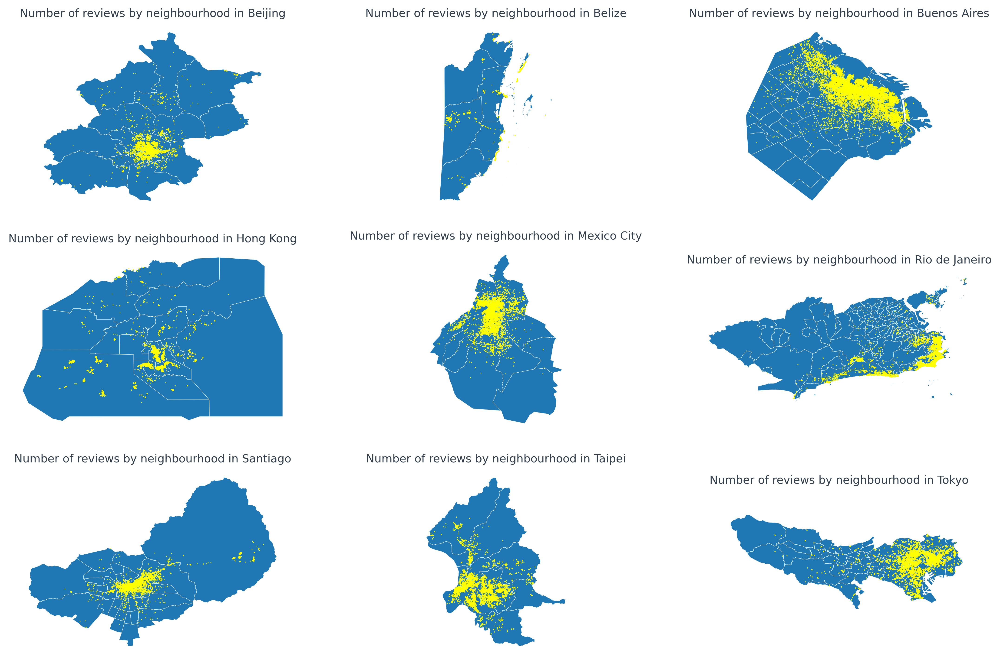

In [55]:
plot_comments_on_map1(
    [[beijing_map_geodf, beijing_comments_english_geodf, 'Beijing'], 
     [belize_map_geodf, belize_comments_english_geodf, 'Belize'],
     [buenos_aires_map_geodf, buenos_aires_comments_english_geodf, 'Buenos Aires'],
     [hong_kong_map_geodf, hong_kong_comments_english_geodf, 'Hong Kong'], 
     [mexico_city_map_geodf, mexico_city_comments_english_geodf, 'Mexico City'],
     [rio_de_janeiro_map_geodf, rio_de_janeiro_comments_english_geodf, 'Rio de Janeiro'],
     [santiago_map_geodf, santiago_comments_english_geodf, 'Santiago'], 
     [taipei_map_geodf, taipei_comments_english_geodf, 'Taipei'],
     [tokyo_map_geodf, tokyo_comments_english_geodf, 'Tokyo', (138.8,140), (35.4,36)]],
    3, 3, non_western_df_english)

### Plot non English comments

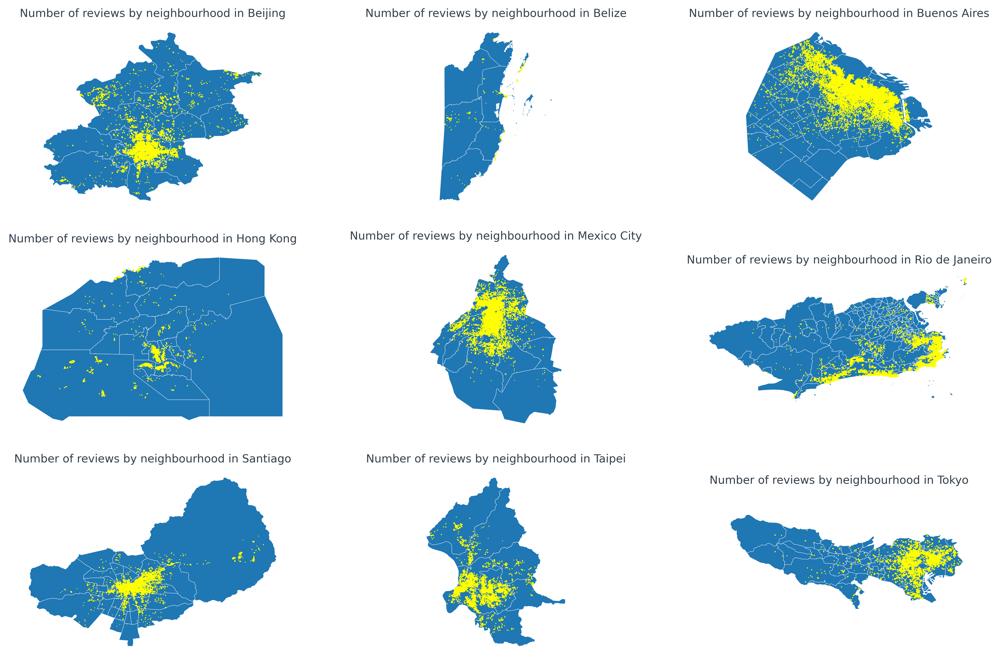

In [56]:
plot_comments_on_map1(
    [[beijing_map_geodf, beijing_comments_non_english_geodf, 'Beijing'], 
     [belize_map_geodf, belize_comments_non_english_geodf, 'Belize'],
     [buenos_aires_map_geodf, buenos_aires_comments_non_english_geodf, 'Buenos Aires'],
     [hong_kong_map_geodf, hong_kong_comments_non_english_geodf, 'Hong Kong'], 
     [mexico_city_map_geodf, mexico_city_comments_non_english_geodf, 'Mexico City'],
     [rio_de_janeiro_map_geodf, rio_de_janeiro_comments_non_english_geodf, 'Rio de Janeiro'],
     [santiago_map_geodf, santiago_comments_non_english_geodf, 'Santiago'], 
     [taipei_map_geodf, taipei_comments_non_english_geodf, 'Taipei'],
     [tokyo_map_geodf, tokyo_comments_non_english_geodf, 'Tokyo', (138.8,140), (35.4,36)]],
    3, 3, non_western_df_non_english)

### Plot listings

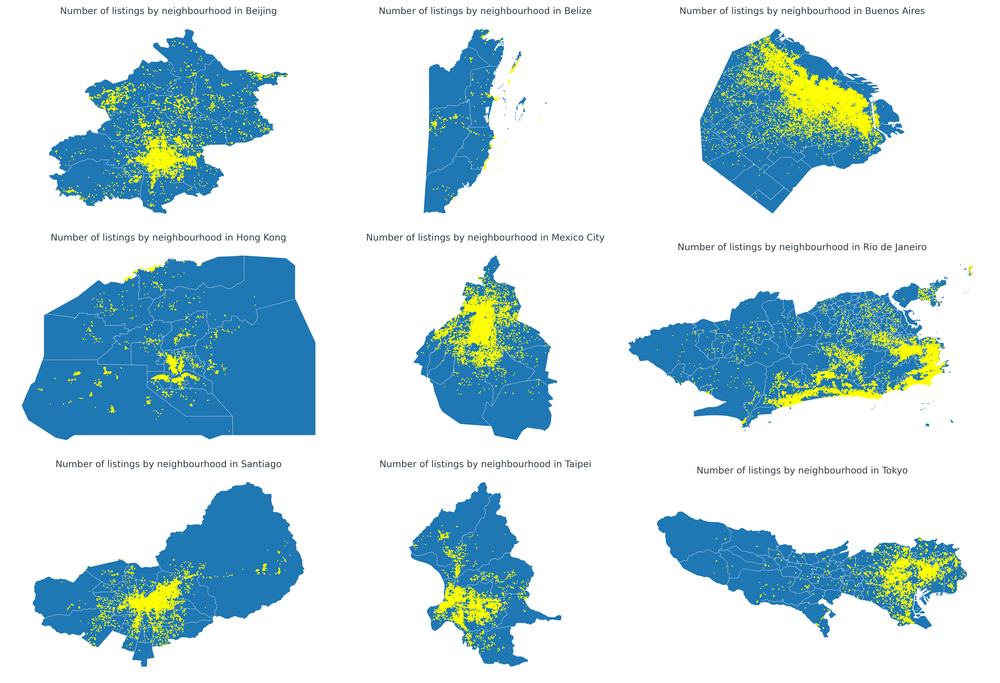

In [57]:
plot_listings_on_map1(
    [[beijing_map_geodf, beijing_listings_geodf, 'Beijing'], 
     [belize_map_geodf, belize_listings_geodf, 'Belize'],
     [buenos_aires_map_geodf, buenos_aires_listings_geodf, 'Buenos Aires'],
     [hong_kong_map_geodf, hong_kong_listings_geodf, 'Hong Kong'], 
     [mexico_city_map_geodf, mexico_city_listings_geodf, 'Mexico City'],
     [rio_de_janeiro_map_geodf, rio_de_janeiro_listings_geodf, 'Rio de Janeiro'],
     [santiago_map_geodf, santiago_listings_geodf, 'Santiago'], 
     [taipei_map_geodf, taipei_listings_geodf, 'Taipei'],
     [tokyo_map_geodf, tokyo_listings_geodf, 'Tokyo', (138.8,140), (35.4,36)]],
    3, 3, listings_non_western_df)

### Plot comments English by neighbourhood

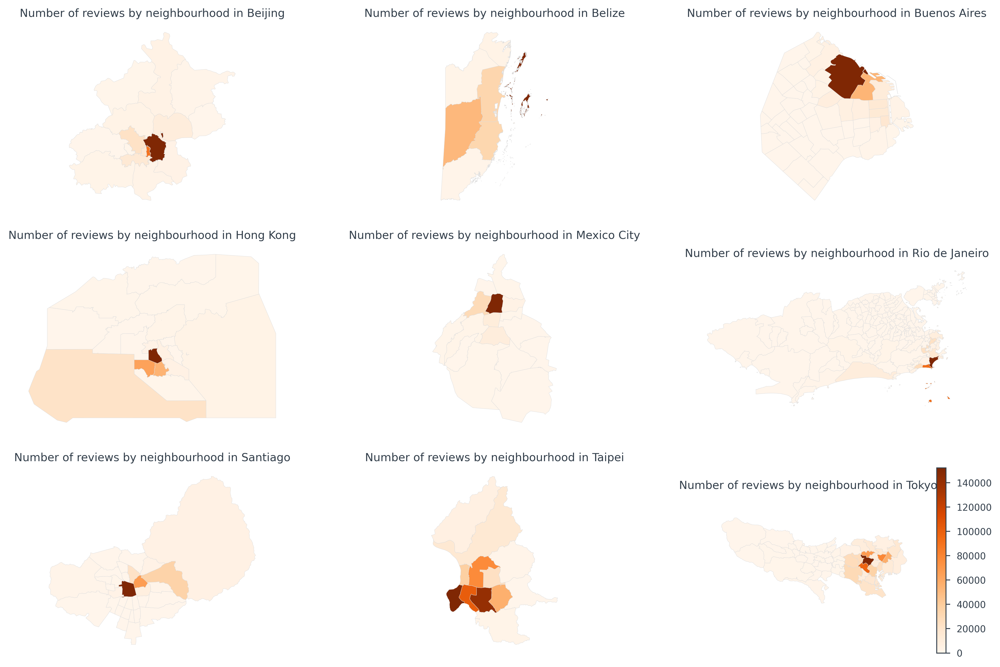

In [58]:
plot_comments_by_neighbourhood_on_map1(
    [[beijing_comments_english_by_neighbourhood_on_map_geodf, 'Beijing'], 
     [belize_comments_english_by_neighbourhood_on_map_geodf, 'Belize'],
     [buenos_aires_comments_english_by_neighbourhood_on_map_geodf, 'Buenos Aires'],
     [hong_kong_comments_english_by_neighbourhood_on_map_geodf, 'Hong Kong'], 
     [mexico_city_comments_english_by_neighbourhood_on_map_geodf, 'Mexico City'],
     [rio_de_janeiro_comments_english_by_neighbourhood_on_map_geodf, 'Rio de Janeiro'],
     [santiago_comments_english_by_neighbourhood_on_map_geodf, 'Santiago'], 
     [taipei_comments_english_by_neighbourhood_on_map_geodf, 'Taipei'],
     [tokyo_comments_english_by_neighbourhood_on_map_geodf, 'Tokyo', (138.8,140), (35.4,36)]],
    3, 3, non_western_df_english, 'comments_english_count')

### Plot comment non English by neighbourhood

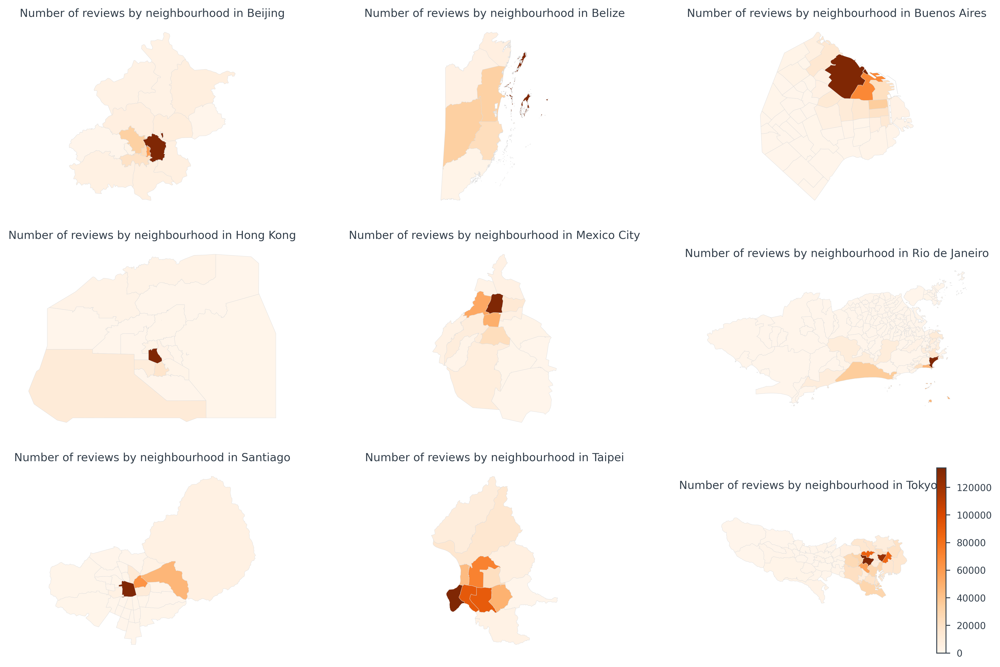

In [59]:
plot_comments_by_neighbourhood_on_map1(
    [[beijing_comments_non_english_by_neighbourhood_on_map_geodf, 'Beijing'], 
     [belize_comments_non_english_by_neighbourhood_on_map_geodf, 'Belize'],
     [buenos_aires_comments_non_english_by_neighbourhood_on_map_geodf, 'Buenos Aires'],
     [hong_kong_comments_non_english_by_neighbourhood_on_map_geodf, 'Hong Kong'], 
     [mexico_city_comments_non_english_by_neighbourhood_on_map_geodf, 'Mexico City'],
     [rio_de_janeiro_comments_non_english_by_neighbourhood_on_map_geodf, 'Rio de Janeiro'],
     [santiago_comments_non_english_by_neighbourhood_on_map_geodf, 'Santiago'], 
     [taipei_comments_non_english_by_neighbourhood_on_map_geodf, 'Taipei'],
     [tokyo_comments_non_english_by_neighbourhood_on_map_geodf, 'Tokyo', (138.8,140), (35.4,36)]],
    3, 3, non_western_df_non_english, 'comments_non_english_count')

### Plot listings by neighbourhood

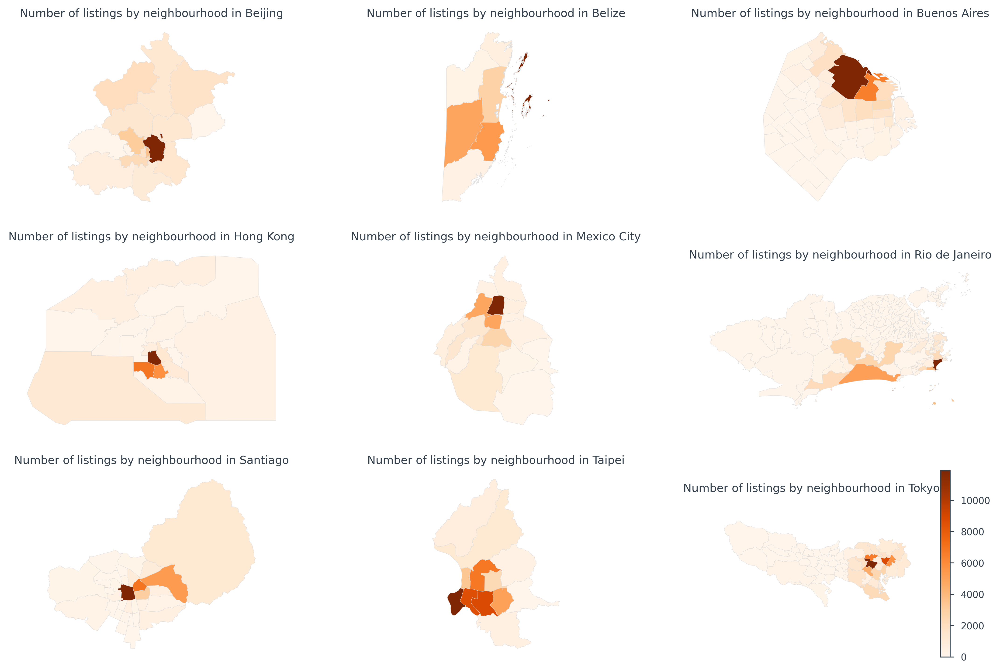

In [60]:
plot_listings_by_neighbourhood_on_map1(
    [[beijing_listings_by_neighbourhood_on_map_geodf, 'Beijing'], 
     [belize_listings_by_neighbourhood_on_map_geodf, 'Belize'],
     [buenos_aires_listings_by_neighbourhood_on_map_geodf, 'Buenos Aires'],
     [hong_kong_listings_by_neighbourhood_on_map_geodf, 'Hong Kong'], 
     [mexico_city_listings_by_neighbourhood_on_map_geodf, 'Mexico City'],
     [rio_de_janeiro_listings_by_neighbourhood_on_map_geodf, 'Rio de Janeiro'],
     [santiago_listings_by_neighbourhood_on_map_geodf, 'Santiago'], 
     [taipei_listings_by_neighbourhood_on_map_geodf, 'Taipei'],
     [tokyo_listings_by_neighbourhood_on_map_geodf, 'Tokyo', (138.8,140), (35.4,36)]],
    3, 3, listings_non_western_df)

### Plot comments and listings on one plot

In [101]:
comments_listings_one_plot(beijing_comments_listings_by_neighbourhood_on_map_geodf, city='Beijing')

NameError: name 'beijing_comments_listings_by_neighbourhood_on_map_geodf' is not defined

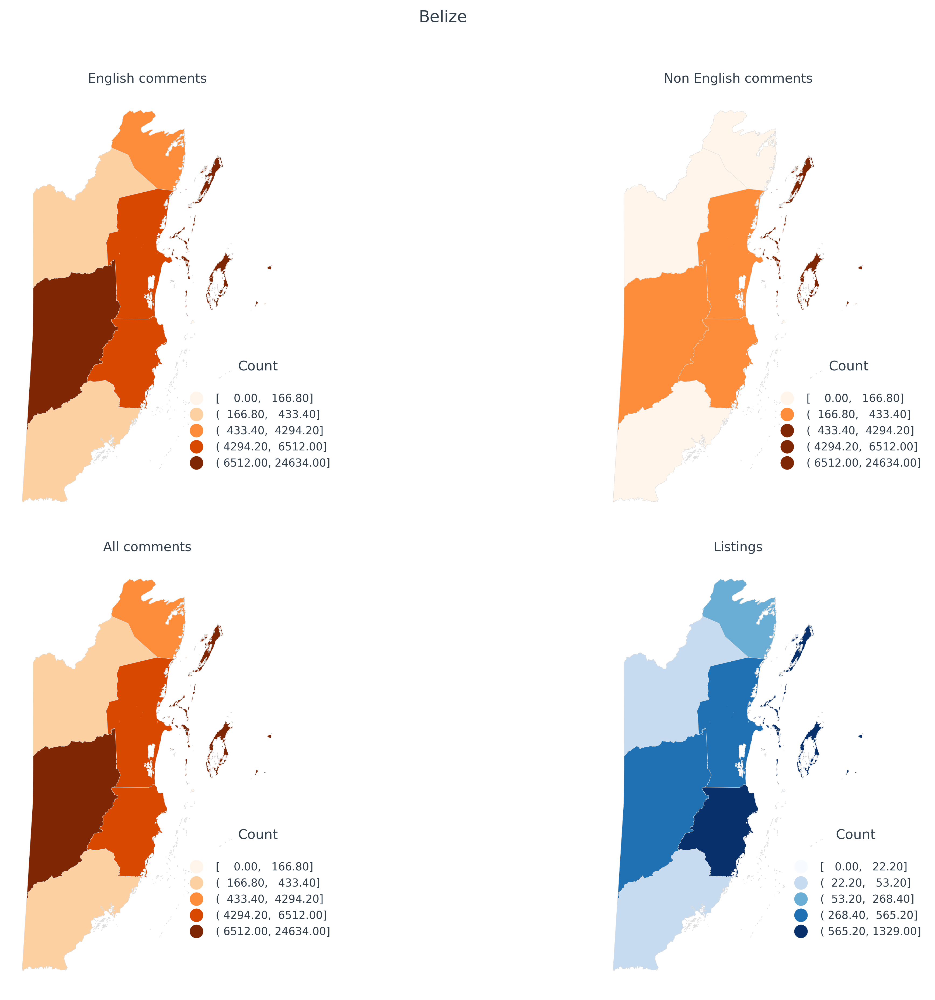

In [162]:
comments_listings_one_plot(belize_comments_listings_by_neighbourhood_on_map_geodf, city='Belize')

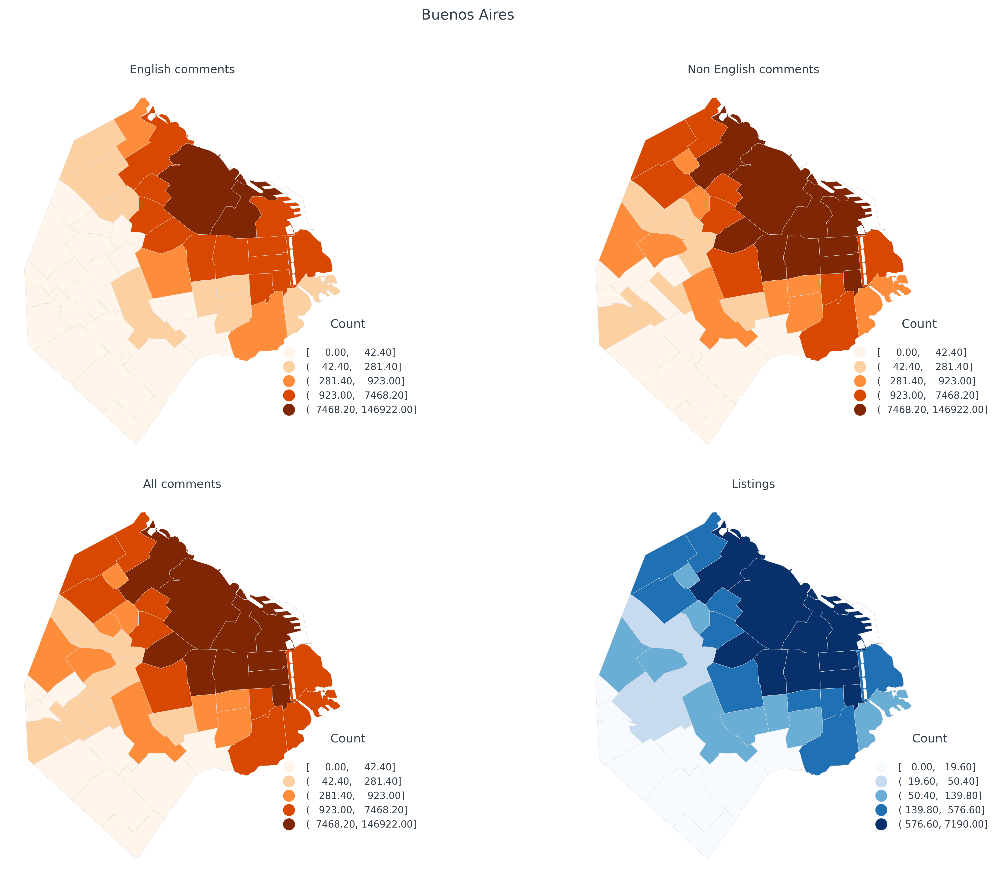

In [163]:
comments_listings_one_plot(buenos_aires_comments_listings_by_neighbourhood_on_map_geodf, city='Buenos Aires')

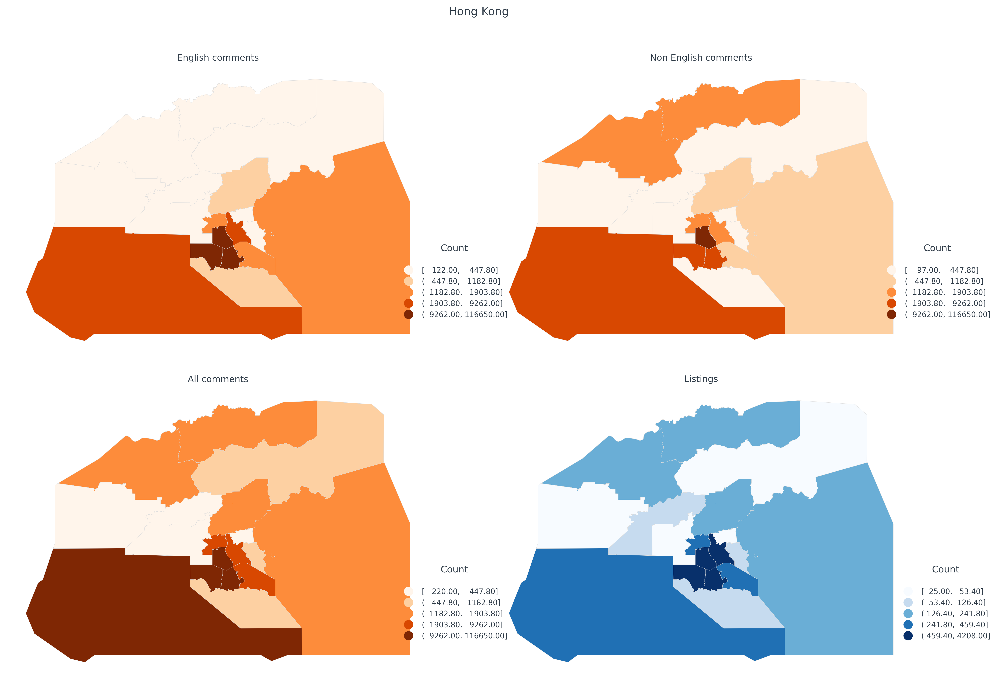

In [164]:
comments_listings_one_plot(hong_kong_comments_listings_by_neighbourhood_on_map_geodf, city='Hong Kong')

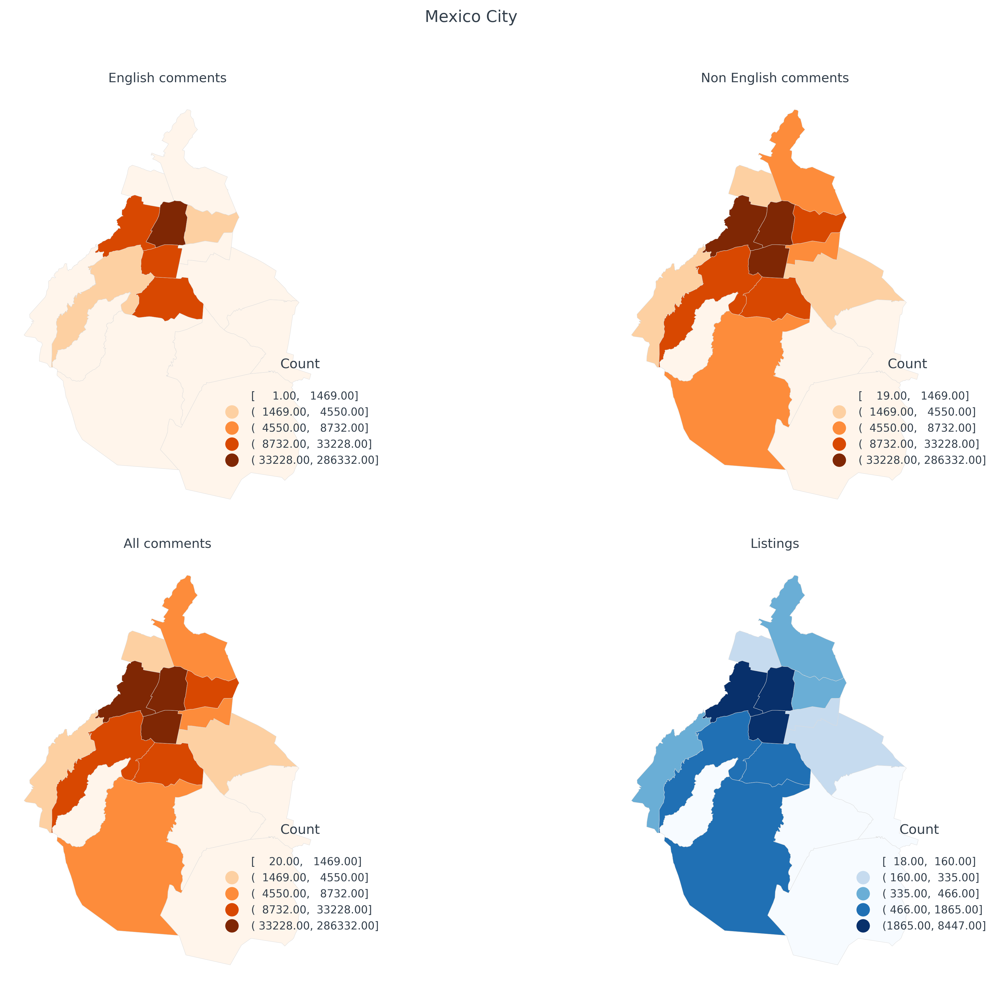

In [165]:
comments_listings_one_plot(mexico_city_comments_listings_by_neighbourhood_on_map_geodf, city='Mexico City')

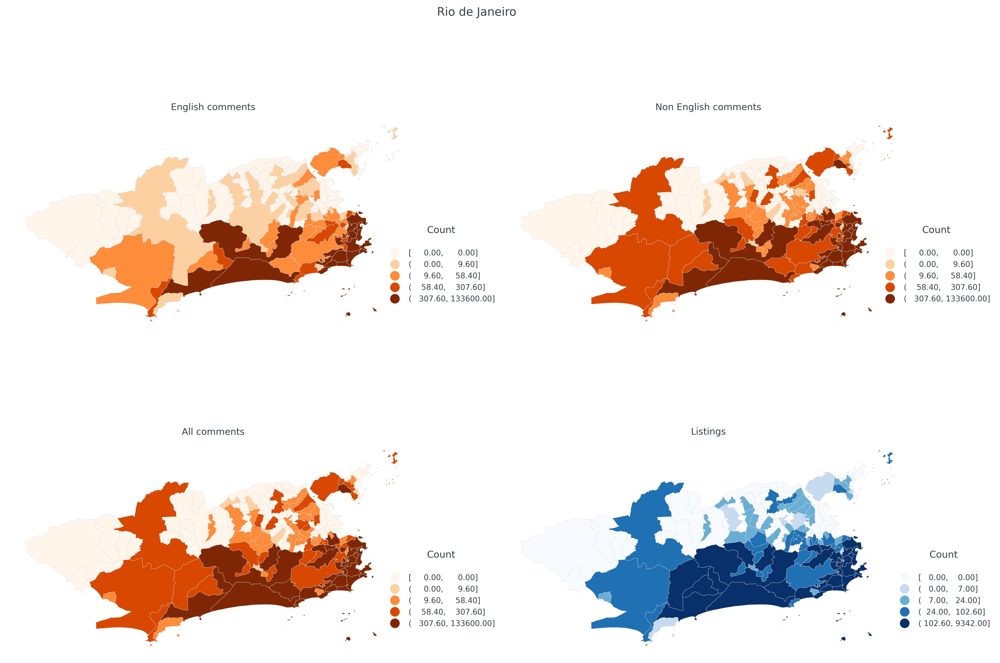

In [166]:
comments_listings_one_plot(rio_de_janeiro_comments_listings_by_neighbourhood_on_map_geodf, city='Rio de Janeiro')

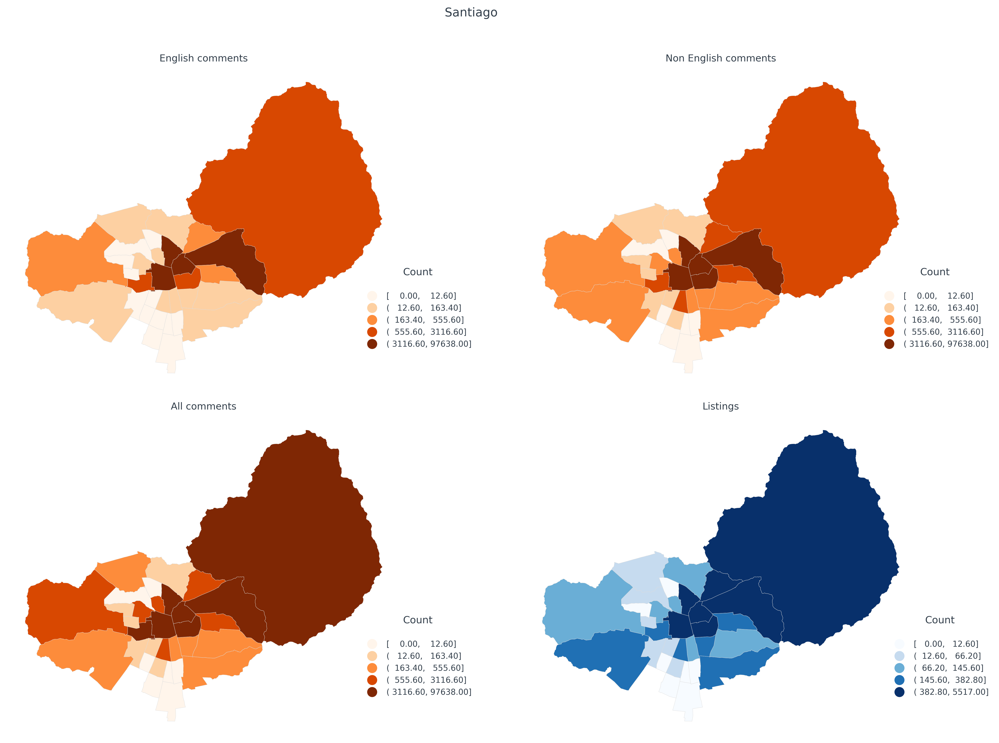

In [167]:
comments_listings_one_plot(santiago_comments_listings_by_neighbourhood_on_map_geodf, city='Santiago')

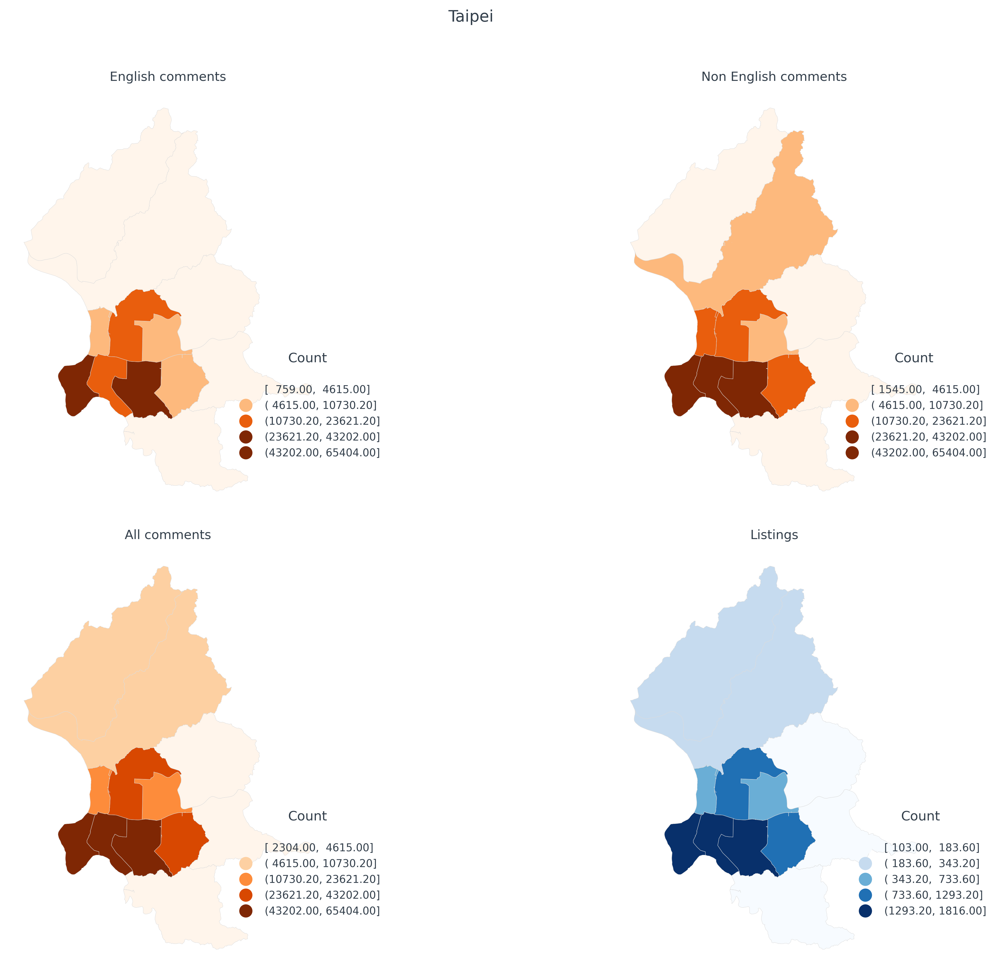

In [168]:
comments_listings_one_plot(taipei_comments_listings_by_neighbourhood_on_map_geodf, city='Taipei')

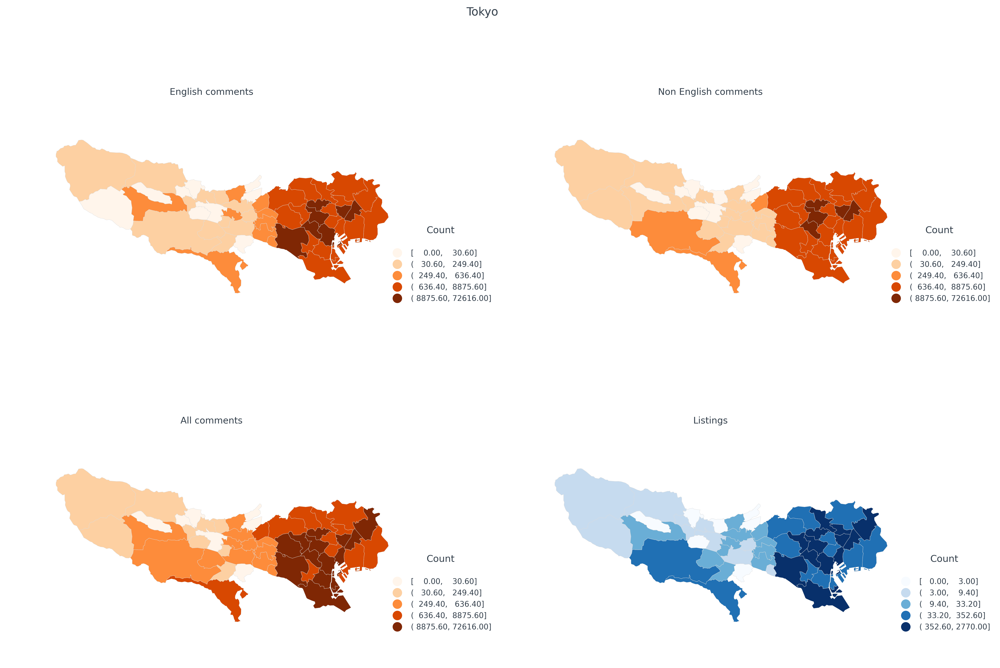

In [171]:
comments_listings_one_plot(tokyo_comments_listings_by_neighbourhood_on_map_geodf, xlim=(138.8,140), ylim=(35.4,36), city='Tokyo')

# Gini index for Airbnb adoption by neighbourhood

In [66]:
def gini(array):
    """Calculate the Gini coefficient of a numpy array."""
    # based on bottom eq: http://www.statsdirect.com/help/content/image/stat0206_wmf.gif
    # from: http://www.statsdirect.com/help/default.htm#nonparametric_methods/gini.htm
    array = array.flatten() #all values are treated equally, arrays must be 1d
    if np.amin(array) < 0:
        array -= np.amin(array) #values cannot be negative
    array += 1 #values cannot be 0
    array = np.sort(array) #values must be sorted
    index = np.arange(1,array.shape[0]+1) #index per array element
    n = array.shape[0]#number of array elements
    return ((np.sum((2 * index - n  - 1) * array)) / (n * np.sum(array))) #Gini coefficient

## comments grouped by city and neighbourhoods english

In [67]:
western_neighbourhoods_grouped_by_city_english = western_df_english.groupby(
    ['city', 'neighbourhood_cleansed'])['comments'].count().reset_index().rename(columns={'comments':'comments_count_english'})

In [68]:
non_western_neighbourhoods_grouped_by_city_english = non_western_df_english.groupby(['city', 'neighbourhood_cleansed'])['comments'].count().reset_index().rename(columns={'comments':'comments_count_english'})

## comments grouped by city and neighbourhood non english

In [69]:
western_neighbourhoods_grouped_by_city_non_english = western_df_non_english.groupby(['city', 'neighbourhood_cleansed'])['comments'].count().reset_index().rename(columns={'comments':'comments_count_non_english'})

In [70]:
non_western_neighbourhoods_grouped_by_city_non_english = non_western_df_non_english.groupby(['city', 'neighbourhood_cleansed'])['comments'].count().reset_index().rename(columns={'comments':'comments_count_non_english'})

## gini for comments english

In [71]:
western_gini_by_city_english = western_neighbourhoods_grouped_by_city_english.groupby(
    ['city'])['comments_count_english'].apply(lambda x: gini(x.values)).reset_index().rename(columns={'comments_count_english':'gini'})

In [72]:
non_western_gini_by_city_english = non_western_neighbourhoods_grouped_by_city_english.groupby(
    ['city'])['comments_count_english'].apply(lambda x: gini(x.values)).reset_index().rename(columns={'comments_count_english':'gini'})

## gini for comments non english

In [73]:
western_gini_by_city_non_english = western_neighbourhoods_grouped_by_city_non_english.groupby(
    ['city'])['comments_count_non_english'].apply(lambda x: gini(x.values)).reset_index().rename(columns={'comments_count_non_english':'gini'})

In [74]:
non_western_gini_by_city_non_english = non_western_neighbourhoods_grouped_by_city_non_english.groupby(
    ['city'])['comments_count_non_english'].apply(lambda x: gini(x.values)).reset_index().rename(columns={'comments_count_non_english':'gini'})

## plot gini index for english comments

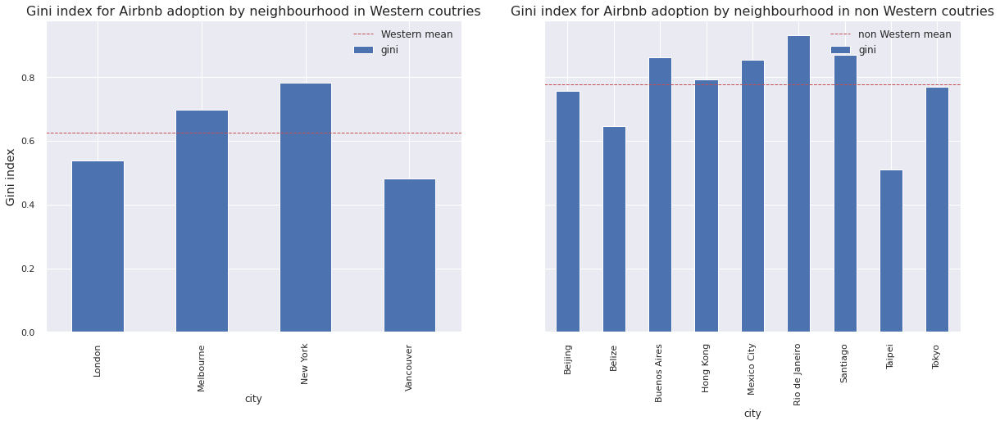

In [75]:
fig, ax = plt.subplots(1, 2, figsize=(20, 7), sharey=True)

ax1 = western_gini_by_city_english.plot(x = 'city', kind='bar', ax=ax[0])
ax1.axhline(western_gini_by_city_english.gini.mean(), color='r', linestyle='dashed', linewidth=1, label='Western mean')
ax1.set_title('Gini index for Airbnb adoption by neighbourhood in Western coutries', fontdict={'fontsize': '16'})
ax1.set_ylabel('Gini index', fontsize=14)
ax1.legend(loc='best', fontsize=12)

ax2 = non_western_gini_by_city_english.plot(x = 'city', kind='bar', ax=ax[1])
ax2.axhline(non_western_gini_by_city_english.gini.mean(), color='r', linestyle='dashed', linewidth=1, label='non Western mean')
ax2.set_title('Gini index for Airbnb adoption by neighbourhood in non Western coutries', fontdict={'fontsize': '16'})
ax2.legend(loc='best', fontsize=12)
plt.show();

## plot gini index for non english comments

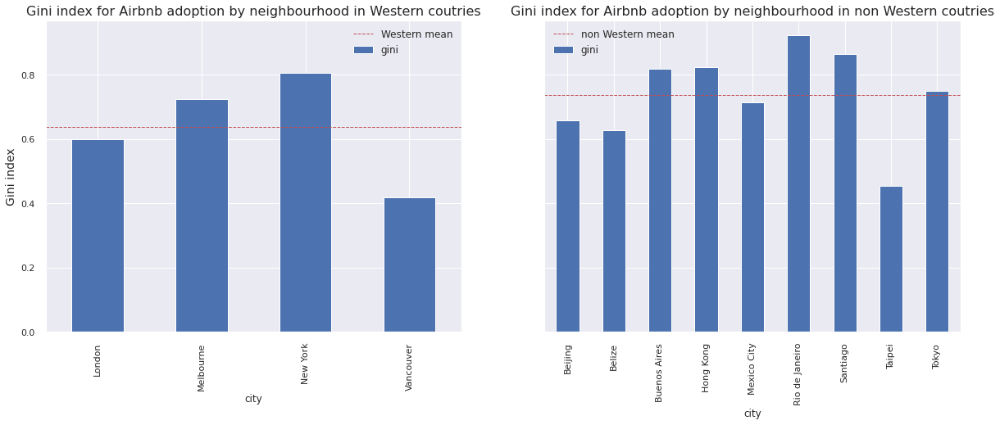

In [76]:
fig, ax = plt.subplots(1, 2, figsize=(20, 7), sharey=True)

ax1 = western_gini_by_city_non_english.plot(x = 'city', kind='bar', ax=ax[0])
ax1.axhline(western_gini_by_city_non_english.gini.mean(), color='r', linestyle='dashed', linewidth=1, label='Western mean')
ax1.set_title('Gini index for Airbnb adoption by neighbourhood in Western coutries', fontdict={'fontsize': '16'})
ax1.set_ylabel('Gini index', fontsize=14)
ax1.legend(loc='best', fontsize=12)
ax2 = non_western_gini_by_city_non_english.plot(x = 'city', kind='bar', ax=ax[1])
ax2.axhline(non_western_gini_by_city_non_english.gini.mean(), color='r', linestyle='dashed', linewidth=1, label='non Western mean')
ax2.set_title('Gini index for Airbnb adoption by neighbourhood in non Western coutries', fontdict={'fontsize': '16'})
ax2.legend(loc='best', fontsize=12)
plt.show();

## comments grouped by year

In [77]:
import datetime

western_df_english['year'] = pd.DatetimeIndex(western_df_english['date']).year
non_western_df_english['year'] = pd.DatetimeIndex(non_western_df_english['date']).year
western_df_non_english['year'] = pd.DatetimeIndex(western_df_non_english['date']).year
non_western_df_non_english['year'] = pd.DatetimeIndex(non_western_df_non_english['date']).year

## english

In [78]:
western_neighbourhoods_grouped_by_city_by_year_english = western_df_english.groupby(
    ['city', 'neighbourhood_cleansed', 'year'])['comments'].count().reset_index().rename(columns={'comments':'comments_count_english'})

In [79]:
non_western_neighbourhoods_grouped_by_city_by_year_english = non_western_df_english.groupby(
    ['city', 'neighbourhood_cleansed', 'year'])['comments'].count().reset_index().rename(columns={'comments':'comments_count_english'})

In [80]:
western_gini_by_city_by_year_english = western_neighbourhoods_grouped_by_city_by_year_english.groupby(
    ['city', 'year'])['comments_count_english'].apply(lambda x: gini(x.values)).reset_index().rename(columns={'comments_count_english':'gini'})

In [81]:
non_western_gini_by_city_by_year_english = non_western_neighbourhoods_grouped_by_city_by_year_english.groupby(
    ['city', 'year'])['comments_count_english'].apply(lambda x: gini(x.values)).reset_index().rename(columns={'comments_count_english':'gini'})

## non english

In [82]:
western_neighbourhoods_grouped_by_city_by_year_non_english = western_df_non_english.groupby(
    ['city', 'neighbourhood_cleansed', 'year'])['comments'].count().reset_index().rename(columns={'comments':'comments_count_non_english'})

In [83]:
non_western_neighbourhoods_grouped_by_city_by_year_non_english = non_western_df_non_english.groupby(
    ['city', 'neighbourhood_cleansed', 'year'])['comments'].count().reset_index().rename(columns={'comments':'comments_count_non_english'})

In [84]:
western_gini_by_city_by_year_non_english = western_neighbourhoods_grouped_by_city_by_year_non_english.groupby(
    ['city', 'year'])['comments_count_non_english'].apply(lambda x: gini(x.values)).reset_index().rename(columns={'comments_count_non_english':'gini'})

In [85]:
non_western_gini_by_city_by_year_non_english = non_western_neighbourhoods_grouped_by_city_by_year_non_english.groupby(
    ['city', 'year'])['comments_count_non_english'].apply(lambda x: gini(x.values)).reset_index().rename(columns={'comments_count_non_english':'gini'})

## plot gini for english reviews by year 

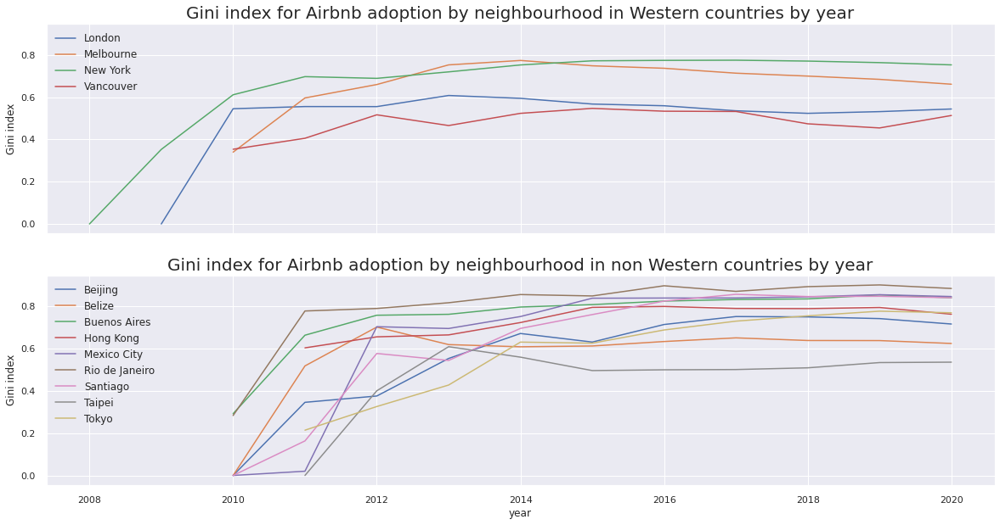

In [86]:
fig, ax = plt.subplots(2, 1, figsize=(20, 10), sharey=True, sharex=True)

ax1 = western_gini_by_city_by_year_english.pivot('year', 'city', 'gini').plot(kind='line', figsize=(20,10), ax=ax[0])
ax1.set_title('Gini index for Airbnb adoption by neighbourhood in Western countries by year', fontdict={'fontsize': '20'})
ax1.set_ylabel('Gini index')
ax1.legend(loc='best', fontsize=12)

ax2 = non_western_gini_by_city_by_year_english.pivot('year', 'city', 'gini').plot(kind='line', figsize=(20,10), ax=ax[1])
ax2.set_title('Gini index for Airbnb adoption by neighbourhood in non Western countries by year', fontdict={'fontsize': '20'})
ax2.set_ylabel('Gini index')
ax2.legend(loc='best', fontsize=12);

## plot gini for non english reviews by year 

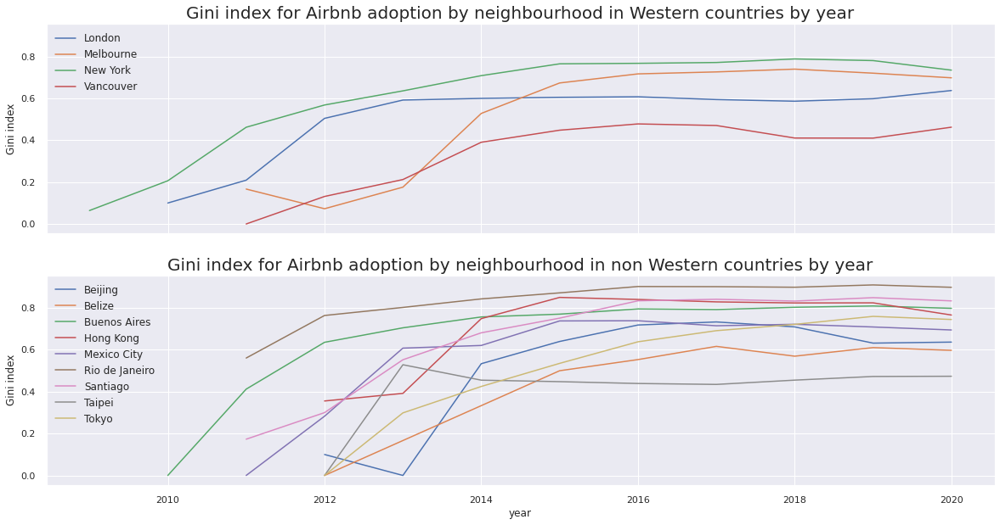

In [87]:
fig, ax = plt.subplots(2, 1, figsize=(20, 10), sharey=True, sharex=True)

ax1 = western_gini_by_city_by_year_non_english.pivot('year', 'city', 'gini').plot(kind='line', figsize=(20,10), ax=ax[0])
ax1.set_title('Gini index for Airbnb adoption by neighbourhood in Western countries by year', fontdict={'fontsize': '20'})
ax1.set_ylabel('Gini index')
ax1.legend(loc='best', fontsize=12)

ax2 = non_western_gini_by_city_by_year_non_english.pivot('year', 'city', 'gini').plot(kind='line', figsize=(20,10), ax=ax[1])
ax2.set_title('Gini index for Airbnb adoption by neighbourhood in non Western countries by year', fontdict={'fontsize': '20'})
ax2.set_ylabel('Gini index')
ax2.legend(loc='best', fontsize=12);

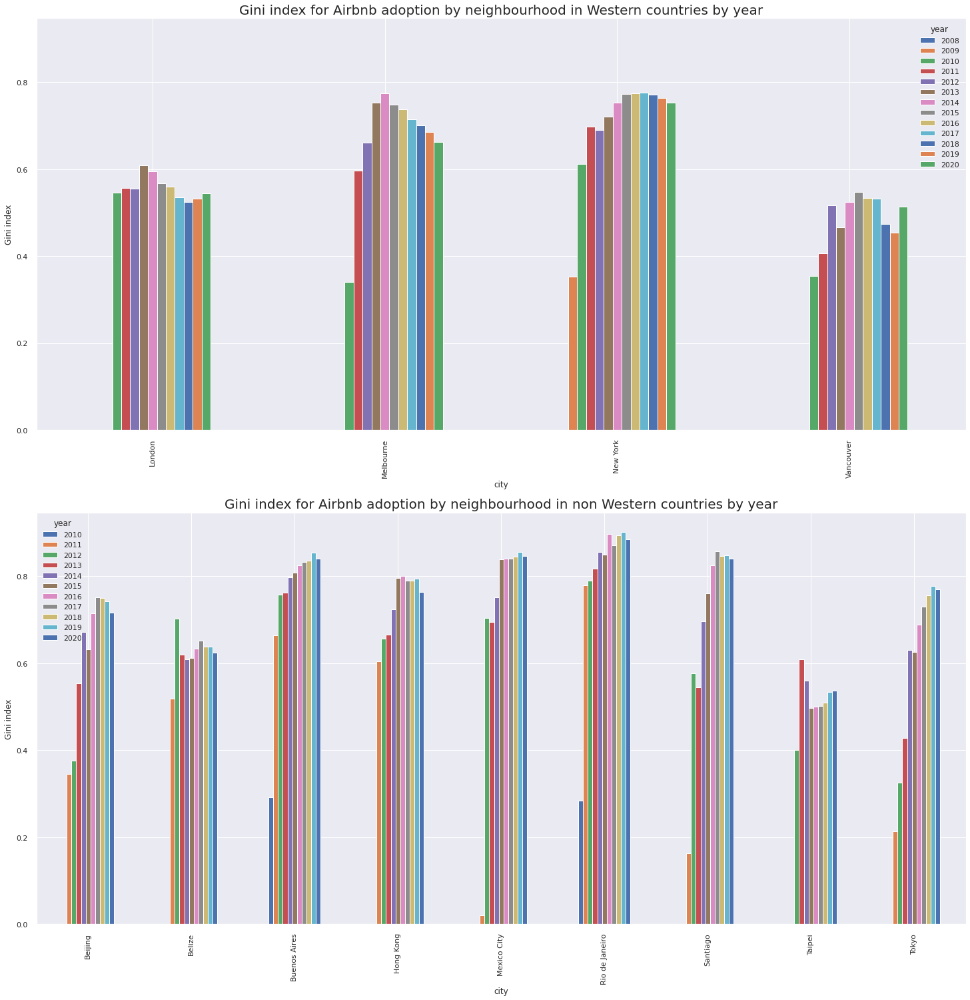

In [88]:
fig, ax = plt.subplots(2, 1, figsize=(20, 20), sharey=True)
ax1 = western_gini_by_city_by_year_english.pivot('city', 'year', 'gini').plot(kind='bar', figsize=(25,25), ax=ax[0])
ax1.set_title('Gini index for Airbnb adoption by neighbourhood in Western countries by year', fontdict={'fontsize': '20'})
ax1.set_ylabel('Gini index')
ax2 = non_western_gini_by_city_by_year_english.pivot('city', 'year', 'gini').plot(kind='bar', figsize=(25,25), ax=ax[1])
ax2.set_title('Gini index for Airbnb adoption by neighbourhood in non Western countries by year', fontdict={'fontsize': '20'})
ax2.set_ylabel('Gini index');

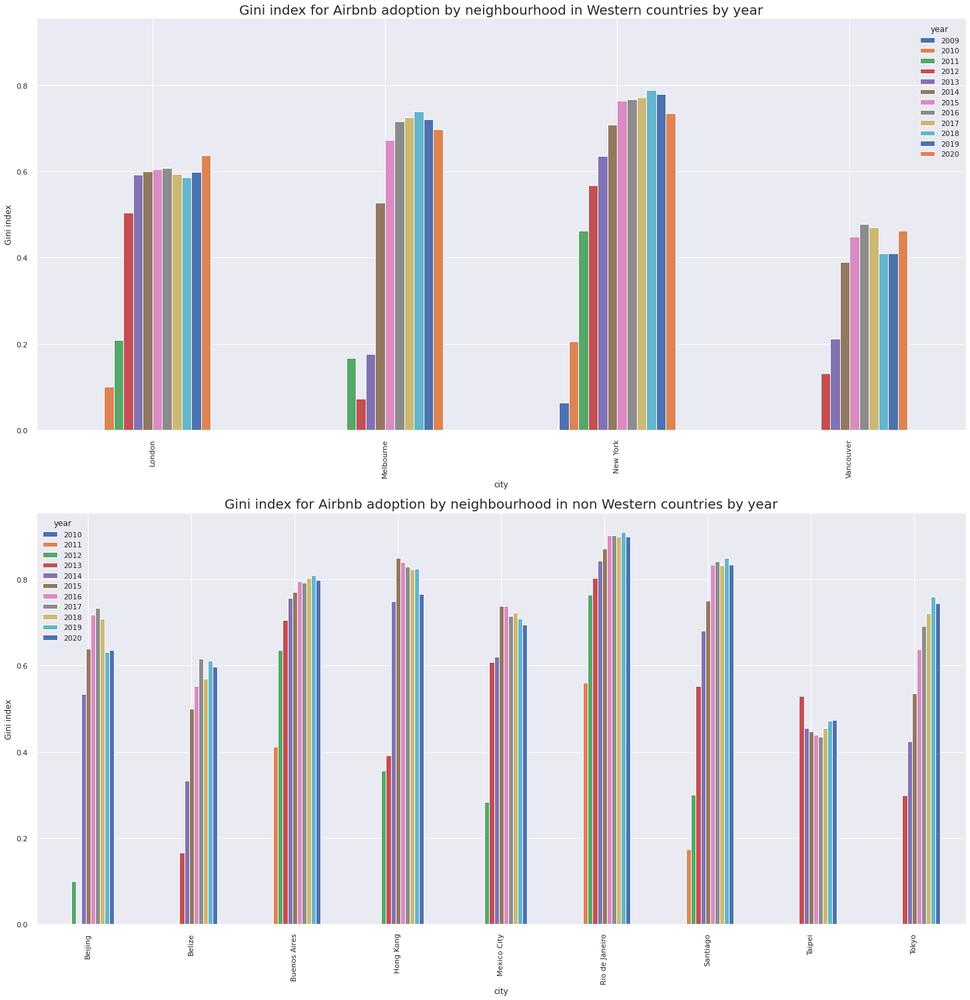

In [89]:
fig, ax = plt.subplots(2, 1, figsize=(20, 20), sharey=True)
ax1 = western_gini_by_city_by_year_non_english.pivot('city', 'year', 'gini').plot(kind='bar', figsize=(25,25), ax=ax[0])
ax1.set_title('Gini index for Airbnb adoption by neighbourhood in Western countries by year', fontdict={'fontsize': '20'})
ax1.set_ylabel('Gini index')
ax2 = non_western_gini_by_city_by_year_non_english.pivot('city', 'year', 'gini').plot(kind='bar', figsize=(25,25), ax=ax[1])
ax2.set_title('Gini index for Airbnb adoption by neighbourhood in non Western countries by year', fontdict={'fontsize': '20'})
ax2.set_ylabel('Gini index');

# Gini index for Airbnb adoption by host

## English comments

In [90]:
western_host_grouped_by_city_english = western_df_english.groupby(
    ['city', 'host_id'])['comments'].count().reset_index().rename(columns={'comments':'comments_count_english'})

In [91]:
western_host_gini_by_city_english = western_host_grouped_by_city_english.groupby(
    ['city'])['comments_count_english'].apply(lambda x: gini(x.values)).reset_index().rename(columns={'comments_count_english':'gini'})

In [92]:
non_western_host_grouped_by_city_english = non_western_df_english.groupby(
    ['city', 'host_id'])['comments'].count().reset_index().rename(columns={'comments':'comments_count_english'})

In [93]:
non_western_host_gini_by_city_english = non_western_host_grouped_by_city_english.groupby(
    ['city'])['comments_count_english'].apply(lambda x: gini(x.values)).reset_index().rename(columns={'comments_count_english':'gini'})

## non English

In [94]:
western_host_grouped_by_city_non_english = western_df_non_english.groupby(
    ['city', 'host_id'])['comments'].count().reset_index().rename(columns={'comments':'comments_count_non_english'})

In [95]:
western_host_gini_by_city_non_english = western_host_grouped_by_city_non_english.groupby(
    ['city'])['comments_count_non_english'].apply(lambda x: gini(x.values)).reset_index().rename(columns={'comments_count_non_english':'gini'})

In [96]:
non_western_host_grouped_by_city_non_english = non_western_df_non_english.groupby(
    ['city', 'host_id'])['comments'].count().reset_index().rename(columns={'comments':'comments_count_non_english'})

In [97]:
non_western_host_gini_by_city_non_english = non_western_host_grouped_by_city_non_english.groupby(
    ['city'])['comments_count_non_english'].apply(lambda x: gini(x.values)).reset_index().rename(columns={'comments_count_non_english':'gini'})

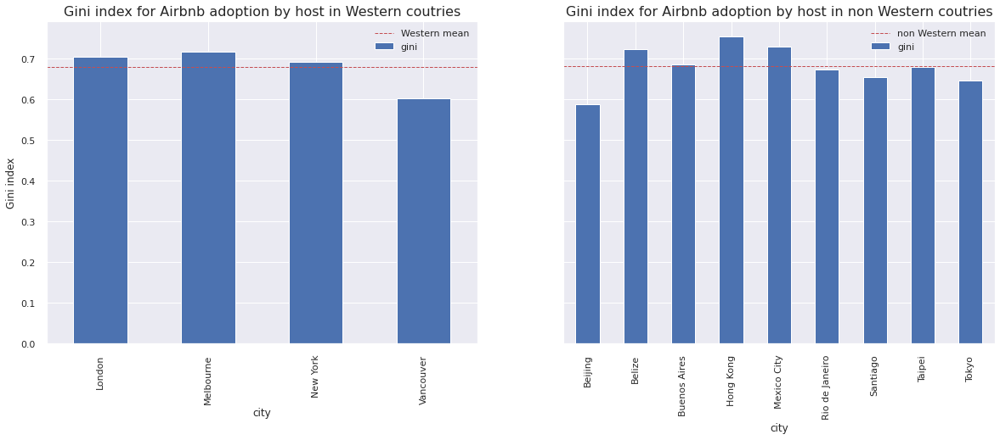

In [98]:
fig, ax = plt.subplots(1, 2, figsize=(20, 7), sharey=True)

ax1 = western_host_gini_by_city_english.plot(x = 'city', kind='bar', ax=ax[0])
ax1.axhline(western_host_gini_by_city_english.gini.mean(), color='r', linestyle='dashed', linewidth=1, label='Western mean')
ax1.set_title('Gini index for Airbnb adoption by host in Western coutries', fontdict={'fontsize': '16'})
ax1.set_ylabel('Gini index')
ax1.legend(loc='best')
ax2 = non_western_host_gini_by_city_english.plot(x = 'city', kind='bar', ax=ax[1])
ax2.axhline(non_western_host_gini_by_city_english.gini.mean(), color='r', linestyle='dashed', linewidth=1, label='non Western mean')
ax2.set_title('Gini index for Airbnb adoption by host in non Western coutries', fontdict={'fontsize': '16'})
ax2.legend(loc='best')
plt.show();

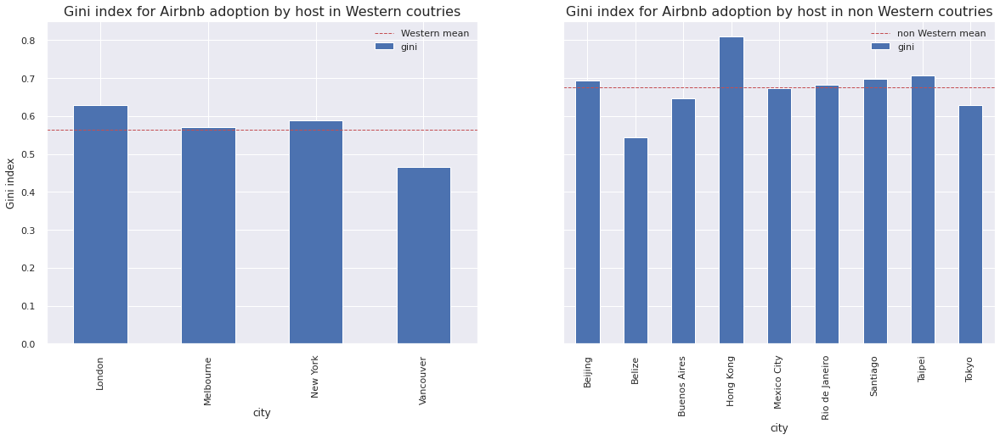

In [99]:
fig, ax = plt.subplots(1, 2, figsize=(20, 7), sharey=True)

ax1 = western_host_gini_by_city_non_english.plot(x = 'city', kind='bar', ax=ax[0])
ax1.axhline(western_host_gini_by_city_non_english.gini.mean(), color='r', linestyle='dashed', linewidth=1, label='Western mean')
ax1.set_title('Gini index for Airbnb adoption by host in Western coutries', fontdict={'fontsize': '16'})
ax1.set_ylabel('Gini index')
ax1.legend(loc='best')
ax2 = non_western_host_gini_by_city_non_english.plot(x = 'city', kind='bar', ax=ax[1])
ax2.axhline(non_western_host_gini_by_city_non_english.gini.mean(), color='r', linestyle='dashed', linewidth=1, label='non Western mean')
ax2.set_title('Gini index for Airbnb adoption by host in non Western coutries', fontdict={'fontsize': '16'})
ax2.legend(loc='best')
plt.show();

## by year English

In [100]:
western_host_grouped_by_city_by_year_english = western_df_english.groupby(
    ['city', 'host_id', 'year'])['comments'].count().reset_index().rename(columns={'comments':'comments_count_english'})

In [101]:
western_host_gini_by_city_by_year_english = western_host_grouped_by_city_by_year_english.groupby(
    ['city', 'year'])['comments_count_english'].apply(lambda x: gini(x.values)).reset_index().rename(columns={'comments_count_english':'gini'})

In [102]:
non_western_host_grouped_by_city_by_year_english = non_western_df_english.groupby(
    ['city', 'host_id', 'year'])['comments'].count().reset_index().rename(columns={'comments':'comments_count_english'})

In [103]:
non_western_host_gini_by_city_by_year_english = non_western_host_grouped_by_city_by_year_english.groupby(
    ['city', 'year'])['comments_count_english'].apply(lambda x: gini(x.values)).reset_index().rename(columns={'comments_count_english':'gini'})

## by year non English

In [104]:
western_host_grouped_by_city_by_year_non_english = western_df_non_english.groupby(
    ['city', 'host_id', 'year'])['comments'].count().reset_index().rename(columns={'comments':'comments_count_non_english'})

In [105]:
western_host_gini_by_city_by_year_non_english = western_host_grouped_by_city_by_year_non_english.groupby(
    ['city', 'year'])['comments_count_non_english'].apply(lambda x: gini(x.values)).reset_index().rename(columns={'comments_count_non_english':'gini'})

In [106]:
non_western_host_grouped_by_city_by_year_non_english = non_western_df_non_english.groupby(
    ['city', 'host_id', 'year'])['comments'].count().reset_index().rename(columns={'comments':'comments_count_non_english'})

In [107]:
non_western_host_gini_by_city_by_year_non_english = non_western_host_grouped_by_city_by_year_non_english.groupby(
    ['city', 'year'])['comments_count_non_english'].apply(lambda x: gini(x.values)).reset_index().rename(columns={'comments_count_non_english':'gini'})

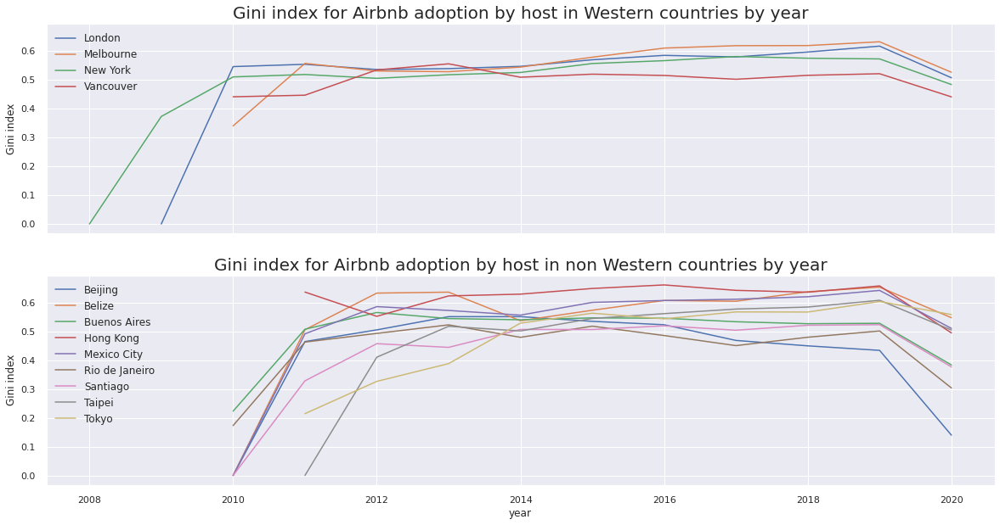

In [108]:
fig, ax = plt.subplots(2, 1, figsize=(20, 10), sharey=True, sharex=True)

ax1 = western_host_gini_by_city_by_year_english.pivot('year', 'city', 'gini').plot(kind='line', figsize=(20,10), ax=ax[0])
ax1.set_title('Gini index for Airbnb adoption by host in Western countries by year', fontdict={'fontsize': '20'})
ax1.set_ylabel('Gini index')
ax1.legend(loc='best', fontsize=12)

ax2 = non_western_host_gini_by_city_by_year_english.pivot('year', 'city', 'gini').plot(kind='line', figsize=(20,10), ax=ax[1])
ax2.set_title('Gini index for Airbnb adoption by host in non Western countries by year', fontdict={'fontsize': '20'})
ax2.set_ylabel('Gini index')
ax2.legend(loc='best', fontsize=12);

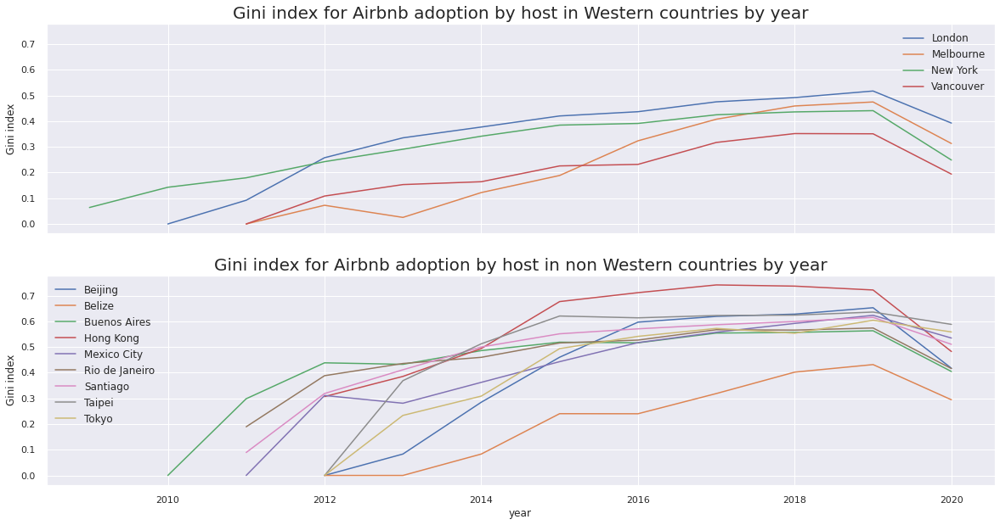

In [109]:
fig, ax = plt.subplots(2, 1, figsize=(20, 10), sharey=True, sharex=True)

ax1 = western_host_gini_by_city_by_year_non_english.pivot('year', 'city', 'gini').plot(kind='line', figsize=(20,10), ax=ax[0])
ax1.set_title('Gini index for Airbnb adoption by host in Western countries by year', fontdict={'fontsize': '20'})
ax1.set_ylabel('Gini index')
ax1.legend(loc='best', fontsize=12)

ax2 = non_western_host_gini_by_city_by_year_non_english.pivot('year', 'city', 'gini').plot(kind='line', figsize=(20,10), ax=ax[1])
ax2.set_title('Gini index for Airbnb adoption by host in non Western countries by year', fontdict={'fontsize': '20'})
ax2.set_ylabel('Gini index')
ax2.legend(loc='best', fontsize=12);

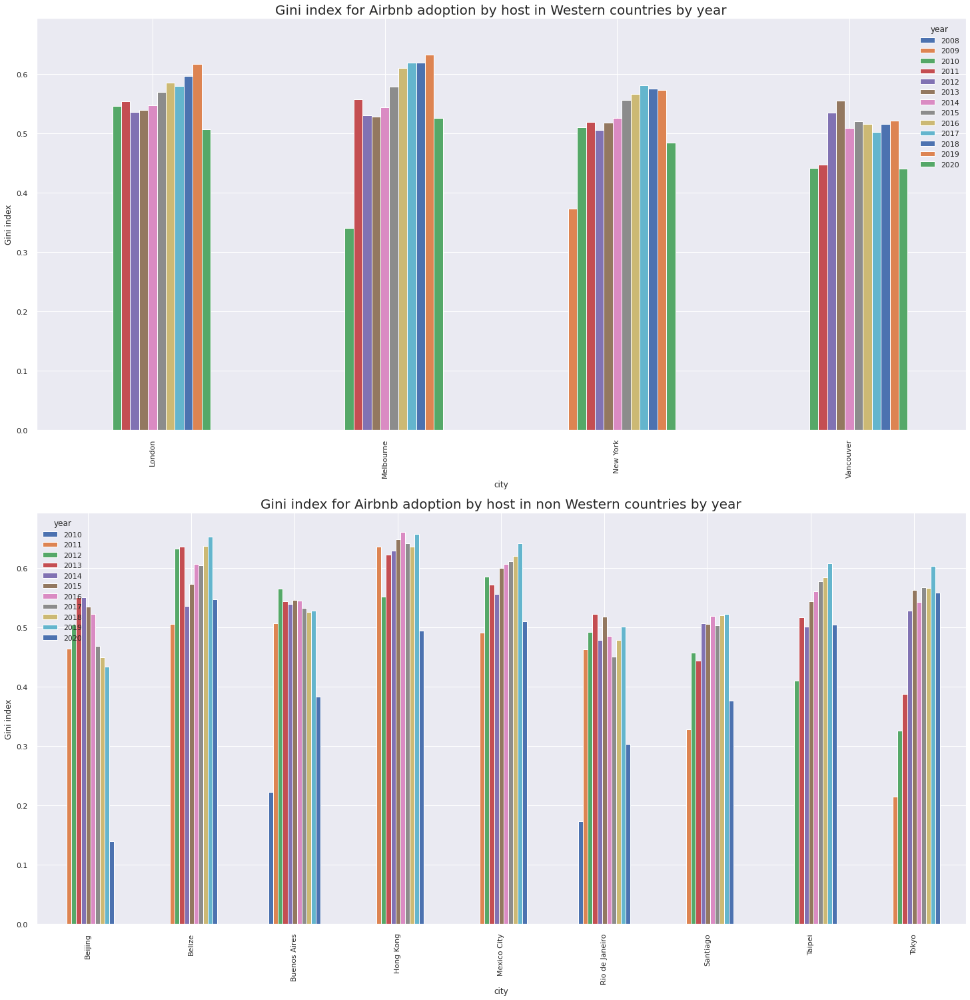

In [110]:
fig, ax = plt.subplots(2, 1, figsize=(20, 20), sharey=True)
ax1 = western_host_gini_by_city_by_year_english.pivot('city', 'year', 'gini').plot(kind='bar', figsize=(25,25), ax=ax[0])
ax1.set_title('Gini index for Airbnb adoption by host in Western countries by year', fontdict={'fontsize': '20'})
ax1.set_ylabel('Gini index')
ax2 = non_western_host_gini_by_city_by_year_english.pivot('city', 'year', 'gini').plot(kind='bar', figsize=(25,25), ax=ax[1])
ax2.set_title('Gini index for Airbnb adoption by host in non Western countries by year', fontdict={'fontsize': '20'})
ax2.set_ylabel('Gini index');

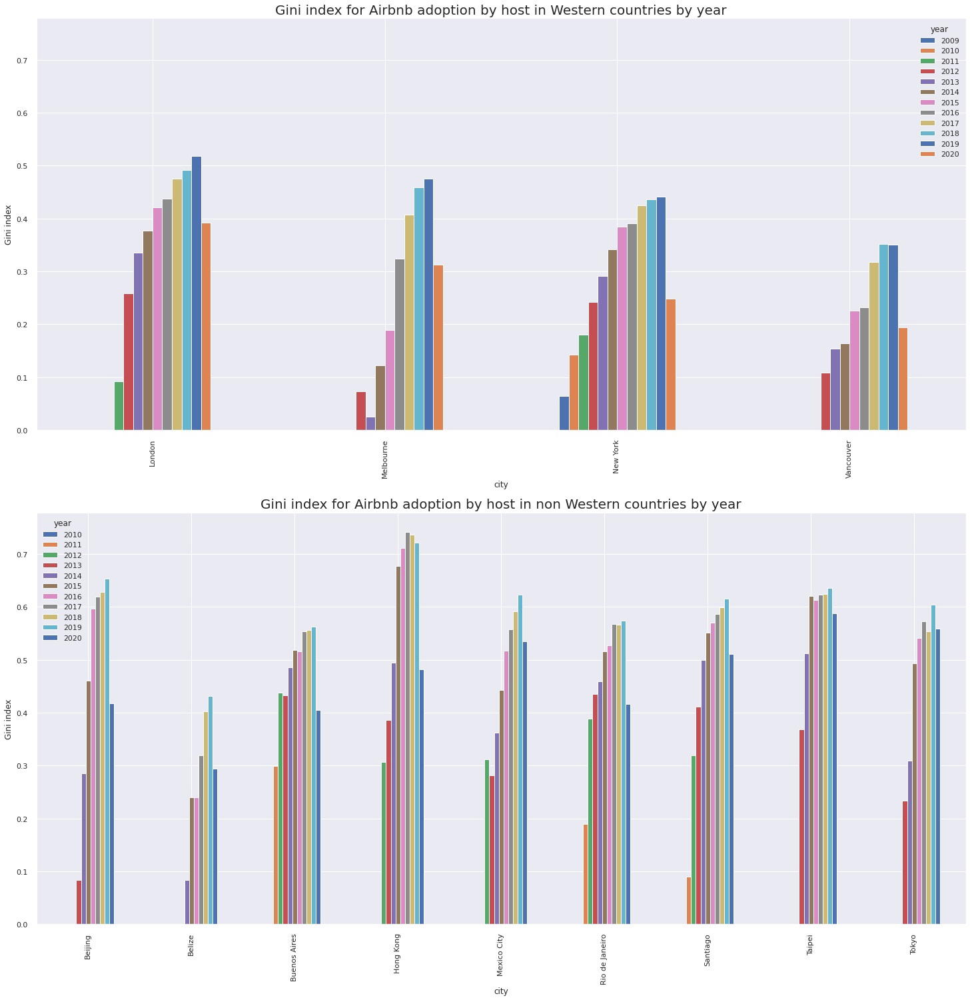

In [111]:
fig, ax = plt.subplots(2, 1, figsize=(20, 20), sharey=True)
ax1 = western_host_gini_by_city_by_year_non_english.pivot('city', 'year', 'gini').plot(kind='bar', figsize=(25,25), ax=ax[0])
ax1.set_title('Gini index for Airbnb adoption by host in Western countries by year', fontdict={'fontsize': '20'})
ax1.set_ylabel('Gini index')
ax2 = non_western_host_gini_by_city_by_year_non_english.pivot('city', 'year', 'gini').plot(kind='bar', figsize=(25,25), ax=ax[1])
ax2.set_title('Gini index for Airbnb adoption by host in non Western countries by year', fontdict={'fontsize': '20'})
ax2.set_ylabel('Gini index');